# Analisi Predittiva di Serie Storiche

Questo notebook si propone come riassunto della nostra esperienza nel tirocinio sulla previsione di serie numeriche temporali.
Il tirocinio è stato diviso in due fasi, ciascuna delle quali corrisponde a un dataset differente:

- previsioni su "negozio Albignasego"
- previsioni su "M5 Competition"

Nella prima fase ciascuno di noi ha scelto in totale autonomia che metodo utilizzare per studiare e successivamente prevedere
le serie temporali che ci sono state fornite, mentre la seconda è stata un lavoro di gruppo in cui abbiamo elaborato una soluzione comune per il problema che ci è stato proposto.

## Indice

Introduzione alle serie storiche e al principio di decomposizione:

- [Concetti teorici](#concetti_teorici)

Questi punti sono le fasi dello studio della serie del negozio Albignasego:

- [ARIMA](#ARIMA)
- [Exponential smoothing](#ETS)
- [Stagionalità multiple](#stagionalità_multiple)

Questo invece è il risultato dello studio dei dati della M5 competition:

- [Serie gerarchiche](#gerarchica-ts)

# Concetti teorici <a class='anchor' id='concetti_teorici'/>

## Cosa sono le serie storiche?

Per serie storica, o temporale, intendiamo una successione di valori, ordinati nel tempo, che catturano l'evoluzione di un dato fenomeno, ad esempio la quantità di merce che si trova in un magazzino oppure l'andamento del settore energetico ecc. Il periodo che passa fra un valore e il successivo può essere fisso o variabile. Noi lavoreremo su serie temporali con "periodo di campionamento" fisso.
<a class='anchor' id='grafico-maglie'/>

<img src="img/esempio_ts.png" alt="Drawing" style="width:90%;"/>
<center><b>Vendite delle maglie del negozio di Albignasego</b></center>

## Componenti delle serie storiche <a class='anchor' id='componenti-ts'/>

Le serie storiche possono risultare difficili da interpretare ed analizzare ad un primo sguardo, ed è quindi molto conveniente dividerle in componenti più semplici che sono: il trend (T), la stagionalità (S) e i residui (R).

Il trend è quel movimento, di lungo periodo, che evidenzia l'andamento generale della serie; in generale ci riferiamo ad esso quando osserviamo un incremento o un decremento (non necessariamente lineare) nei dati.

La stagionalità invece è un'oscillazione che dipende da fattori legati al tempo, al clima o a "periodicità" di altra natura. Questa componente ha un andamento simile a quello di una funzione periodica, simile in quanto i metodi di decomposizione moderni tendono a far sì che $f(t)\approx f(t + \tau)$, dove $\tau$ indica il periodo.

I residui infine sono un movimento di natura irregolare e lo possiamo pensare come l'errore che abbiamo fra la serie originale e la somma o prodotto delle due componenti (T e S). La caratteristica di questa componente è quella di essere stazionaria in media cioè di oscillare intorno ad un valore costante 0.

Formalmente la decomposizione la possiamo definire in due modi, in modo addittivo $y_t = T_t + S_t + R_t$ e in modo moltiplicativo $y_t = T_t * S_t * R_t$. Usiamo il modello addittivo quando l'ampiezza di $S_t$ non varia a seconda del livello della serie mentre usiamo il moltiplicativo quando all'aumentare del livello della serie proporzionalmente aumenta o diminuisce l'ampiezza della stagionalità. Va inoltre ricordato che usando le proprietà dei logaritmi possiamo scrivere: $\log{y_t}=\log({T_t * S_t * R_t})=\log{T_t}+\log{S_t}+\log{R_t}$.
<a class='anchor' id='grafico-decomposizione'/>

<img src="img/esempio_decomposizione.png" alt="Drawing" style="width:90%;"/>
<center><b>Decomposizione additiva sulle vendite delle maglie del negozio di Albignasego</b></center>

## Media mobile

Prima di introdurre il principio della decomposizione, va definito lo strumento con cui estrarre da una serie temporale la componente trend. La media mobile di ordine m (m - MA) viene scritta come:
\begin{equation*}
T_t=\frac{1}{m} \sum_{i=-k}^k y_{t+i}
\end{equation*}

dove $m = 2k + 1$. Eseguire la media nell'intorno $[t-k \dots t+k]$ consente di eliminare una parte dei disturbi presenti nelle osservazioni; infatti per valori molto vicini fra loro la media risulterà quasi uguale ai valori stessi.

Nel caso in cui m sia un valore pari allora definiremo la 2 x m - MA come la media mobile m - MA seguita poi da una 2 - MA. La 2 - MA viene applicata per avere un risultato simmetrico. Ad esempio, supponiamo di dover calcolare la 2 x 4 - MA allora:

\begin{equation*}
T_t=\frac{1}{2}[\frac{1}{4}(y_{t-2}+y_{t-1} + y_{t} + y_{t+1}) + \frac{1}{4}(y_{t-1}+y_{t} + y_{t+1} + y_{t+2})] \\
=\frac{1}{8}y_{t-2} + \frac{1}{4}y_{t-1} + \frac{1}{4}y_{t} + \frac{1}{4}y_{t+1} + \frac{1}{8}y_{t+2}
\end{equation*}

## Metodo di decomposizione classico

Nonostante questo metodo sia stato introdotto circa un secolo fa, è ancora importante poiché costituisce la base dei moderni metodi di decomposizione come X11, SEATS e STL (questi presentano step aggiuntivi rispetto al metodo classico). Il metodo consta di 3 passaggi:

1. Uso della media mobile di ordine m (o 2 x m) sulla serie $y_t$ per individuare la componente trend.

2. Supponendo $y_t$ sia a valori mensili, allora si calcola la media dei valori della serie $y_t - T_t$ (serie de-trendizzata) che fanno riferimento allo stesso mese. In questo modo otterremo 12 valori. Infine costruiamo la componente stagionale $S_t$ replicando i valori appena ottenuti per tutti gli anni della serie.

3. I residui si trovano semplicemente eseguendo $R_t = y_t - T_t - S_t$.

Per il modello moltiplicativo i passaggi sono pressoché identici, tuttavia la serie de-trendizzata si trova facendo $\frac {y_t} {T_t}$ mentre i residui facendo $R_t = \frac{y_t}{T_t S_t}$.

### Problematiche

All'apparenza il metodo classico sembra comportarsi bene, tuttavia esistono due principali problematiche:

- Se consideriamo di trovare $T_t$ usando 11-MA vedremo che per le prime e le ultime 5 osservazioni della serie $y_t$ non saranno disponibili i corrispettivi valori di $T_t$ in quanto cercheremo di eseguire la media su valori non esistenti. Esempio per t=1 dovremmo calcolare la media delle osservazioni nell'intervallo [1-5 .. 1+5], e i valori per -1, -2, ecc. non sono presenti.

- Il modo in cui la componente stagionale viene determinata può funzionare per serie temporali non troppo lunghe ma soprattutto dove il pattern della stagionalità non varia particolarmente nel tempo.

## Misure del trend e della stagionalità

Sfruttando la decomposizione appena introdotta, possiamo ora misurare la forza delle componenti trend e stagionalità nelle serie storiche. Supponiamo di avere $y_t = T_t + S_t + R_t$ con una forte impronta del trend, allora la serie de-stagionalizzata (togliamo la stagionalità per misurare il trend) avrà variazioni molto maggiori dei residui. Con $F_T$ indichiamo la forza del trend che calcoliamo come:
\begin{equation*}
F_T=max\Big(0, 1-\frac{Var(R_t)}{Var(T_t + R_t)}\Big)
\end{equation*}

In questo modo, più $F_T$ è vicino a 1 più la componente è presente all'interno della serie. L'uso della funzione $max()$ è giustificato dal fatto che a volte capita che la varianza dei residui sia molto maggiore della varianza calcolata su $T_t + R_t$ quindi il rapporto delle due varianze genera un valore $> 1$. 

Analogamente a sopra, possiamo calcolare la forza della stagionalità calcolando il rapporto fra la varianza dei residui e la varianza della serie de-trendizzata:

\begin{equation*}
S_T=max\Big(0, 1-\frac{Var(R_t)}{Var(S_t + R_t)}\Big)
\end{equation*}

## Previsioni con decomposizione

La decomposizione può essere usata anche per le previsioni. Se consideriamo $y_t$ decomposta addittivamente ($y_t=T_t + S_t + R_t$) e supponiamo che la stagionalità non vari in maniera importante allora la previsione della stagionalità viene eseguita usando un seasonal-naif (replichiamo il valore di $m$ istanti fa, dove m è la stagionalità della serie), mentre per le altre componenti possono essere usati ARIMA, Simple Exponention Smoothing ecc. 

Questo modus operandi è vantaggioso soprattutto quando le serie temporali sono a stagionalità multipla. Usando ARIMA o ETS generiamo di solito delle previsioni meno accurate (a causa della stagionalità multipla) rispetto a decomporre la serie ed eseguire le previsioni sulle componenti semplici.

# Confronto tra modelli

Nel primo lavoro ci è stato fornito un insieme di dati riguardanti le vendite nel periodo 23/03/2013-29/09/2019 di un negozio di capi di abbigliamento. Abbiamo deciso di concentrarci unicamente sulla serie delle maglie in quanto il comportamento delle serie degli altri capi di abbiagliamento risultava analogo. Abbiamo diviso la serie nei due set di training (contenente l'80% delle osservazioni) e di validazione (contenente il 20% da confrontare con i risultati delle previsioni) e successivamente ci siamo concentrati sull'applicazione di modelli per le previsioni con lo scopo di trovare quelli che fornissero i risultati migliori.

## Studio della serie

Per lo studio della serie ci siamo serviti di una serie di librerie che potessero fornire una serie di strumenti per estrarre o determinare le sue caratteristiche, oltre alle librerie per la manipolazione dei dati.

In [2]:
import math
import itertools #realizzazione combinazioni per testare tutti i possibili ordini
import numpy as np #strumenti matematici (metriche d'errore etc.)
import pandas as pd #gestione serie temporali/dataframe
import matplotlib.pyplot as plt #stampa dei grafici
import datetime as dt #manipolazione date
from statsmodels.tsa.arima_model import ARIMA #modello ARIMA
from statsmodels.tsa.seasonal import seasonal_decompose #decomposizione serie in componenti
from statsmodels.tsa.stattools import adfuller #metrica Dickey-Fuller per stazionarietà
from statsmodels.tsa.stattools import kpss #metrica kpss per trend stazionarietà
from statsmodels.tsa.stattools import acf, pacf #per la realizzazione dei grafici di autocorrelazione e autorcorrelazione parziale
from statsmodels.tsa.holtwinters import SimpleExpSmoothing #modello Simple ETS
from statsmodels.tsa.holtwinters import ExponentialSmoothing #modello  ETS
from sklearn.metrics import mean_squared_error #metrica di errore MSE

Per studiare la stagionalità della serie abbiamo utilizzato i grafici di autocorrelazione e autocorrelazione parziale. 
I grafici di autocorrelazione forniscono i valori di autocorrelazione di una serie con i suoi valori spostati di un certo lag, descrivendo quindi come i valori della serie in un certo momento siano in relazione con i valori passati. La funzione di autocorrelazione non fa distinzione tra le componenti della serie.
I grafici di autocorrelazione parziale invece trattano la correlazione tra residui e residui spostati di un certo lag, mettendo in evidenza informazioni nascoste ancora presenti nei residui.
I picchi più alti rappresentano i valori di stagionalità più interessanti da studiare.

In [3]:
def ac_pac_function(timeseries, lags=40):

    """
    Parameters
    ----------
    timeseries : pd.Series
        La serie su cui calcolare le funzioni di auto-correlazione e autocorrelazione parziale
    lags : int, optional
        Il lag massimo rappresentato nel grafico. The default is 20.

    Returns
    -------
    None.
    """

    lag_acf = acf(timeseries, nlags=lags, fft=True)
    lag_pacf = pacf(timeseries, nlags=lags, method='ols')
    
    plt.figure(figsize=(40, 20), dpi=80)
    
    #Plot ACF:
    
    plt.subplot(211)     
    plt.plot(lag_acf, color = 'orange')
    
    #Delimito i tre intervalli
    
    plt.axhline(y=0,linestyle='--',color='gray')
    plt.axhline(y=-1.96/np.sqrt(len(timeseries)),linestyle='--',color='black')
    plt.axhline(y=1.96/np.sqrt(len(timeseries)),linestyle='--',color='black')
    plt.title('Autocorrelation function')
    
    #Plot PACF
    
    plt.subplot(212)
    plt.plot(lag_pacf, color = 'orange')
    
    #Delimito i tre intervalli
    
    plt.axhline(y=0,linestyle='--',color='gray')
    plt.axhline(y=-1.96/np.sqrt(len(timeseries)),linestyle='--',color='black')
    plt.axhline(y=1.96/np.sqrt(len(timeseries)),linestyle='--',color='black')
    plt.title('Partial Autocorrelation Function')
    plt.tight_layout()

Il test di Dickey Fuller è uno dei più utilizzati per determinare la stazionarietà o meno di una serie. Utilizzando un modello autoregressivo è in grado di determinare quanto una serie sia influenzata dalla presenza di un trend.
L'ipotesi nulla del test afferma che i nostri dati non siano stazionari, ossia che sia presente una struttura dipendente dal tempo: per respingere tale ipotesi occorre un p-value inferiore a 0.05. L'ipotesi alternativa invece ci permette di affermare che la serie sia stazionaria.
- Ipotesi nulla: se non è possibile respingerla (si ha un p-value > 0.05) allora significa che nei dati è presente una radice unitaria e, di conseguenza, che è presente una struttura dipendente dal tempo e quindi che i dati non sono stazionari
- Ipotesi alternativa: l'ipotesi nulla è respinta (si ha un p-value <= 0.05), quindi i dati sono privi di una radice unitaria e sono stazionari

In [4]:
def test_stationarity(timeseries):    
    
    """
    Parameters
    ----------
    timeseries : pd.Series
        La serie di cui calcolare la stazionarietà con il metodo Dickey-Fuller
    Returns
    -------
    None.
    """
    
    # Dickey-Fuller test: il numero di lag è scelto per minimizzare la metrica AIC, una misura della qualità della stima di un modello 
    # statistico tenendo conto sia della bontà di adattamento (che migliora il punteggio) che della complessità del modello (all'aumentare
    # della complessità il punteggio peggiora). Un AIC più basso è sinonimo di un modello migliore.
    
    print('Results of Dickey-Fuller Test:')
    dftest = adfuller(timeseries, autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used'])
    
    # Valori critici
    
    for key, value in dftest[4].items():
        dfoutput['Critical Value (%s)' % key] = value
    print(dfoutput)
    print('\n')
    if(dfoutput['Test Statistic']<dfoutput['Critical Value (1%)']):
        print("La serie è stazionaria (test Dickey-Fuller)")
    else:
        print("La serie non è stazionaria (test Dickey-Fuller)")

### Creazione della serie e definizione costanti

In [5]:
# Costanti per grandezza testo

SMALL_SIZE = 28 
MEDIUM_SIZE = 30 
BIGGER_SIZE = 32 

# Inizializzazione caratteristiche base dei PLOT

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes 
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title 
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels 
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the x tick labels 
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the y tick labels 
plt.rc('legend', fontsize=SMALL_SIZE)    # fontsize of the legend
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

# COLORI

TSC = 'black'   # training set
VSC = 'black'   # validation set
FC = 'red'      # previsioni
MRC = 'green'   # model results
OLC = 'orange'  # other lines

# STAGIONI  (in numero di giorni)

two_years = 365 * 2
year = 365 
half_year = 183
week = 7

seasons = [year, half_year, week]

# STAGIONE SELEZIONATA PER ESECUZIONE, MODIFICABILE

season = year

# L'insieme di dati contiene la data e il numero di capi di abbigliamento venduti
# in quel giorno (per tipo).
# Faccio in modo che la data sia letta per ottenere una serie temporale

dateparse = lambda dates: dt.datetime.strptime(dates, '%Y-%m-%d')
data = pd.read_csv('./NEGOZIO_ABBIGLIAMENTO/Dati_Albignasego/Whole period.csv', index_col=0, date_parser=dateparse)

# usiamo solo la serie maglie. In modo analogo il procedimento può essere ripetetuto per ciascun capo...

ts = data['MAGLIE']

In [6]:
# Costanti per spezzare la serie temporale sempre nello stesso punto

START_TRAIN = ts.index[0]
END_TRAIN = ts.index[int(len(ts) * 0.8)]
START_VALID = ts.index[int(len(ts)*0.8)+1]
END_VALID = ts.index[int(len(ts))-1]

# Se si volesse togliere il 29 febbraio 2016 per avere solo anni di 365 giorni. 
"""ts = ts.drop(labels=[pd.Timestamp('2016-02-29')])"""

train = ts[pd.date_range(start=START_TRAIN, end=END_TRAIN, freq='D')]
valid = ts[pd.date_range(start=START_VALID, end=END_VALID, freq='D')]

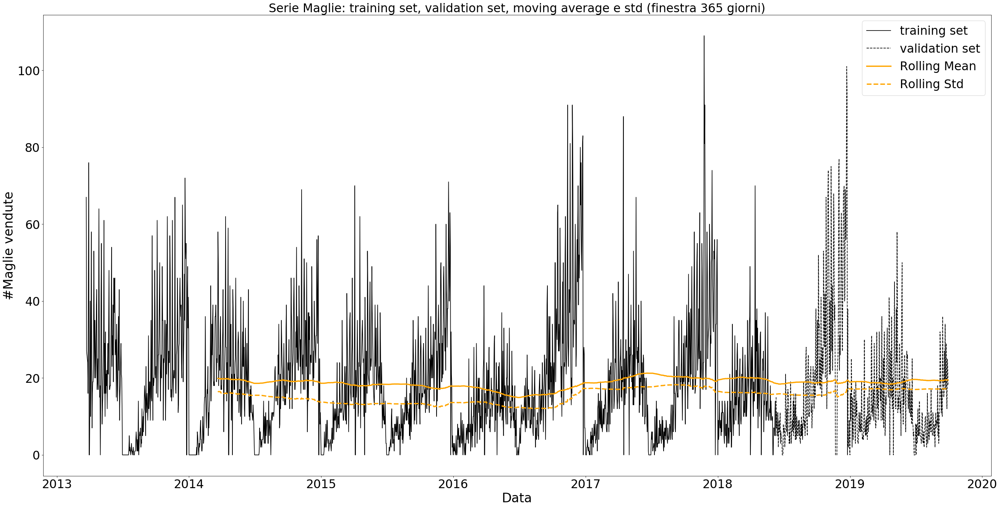

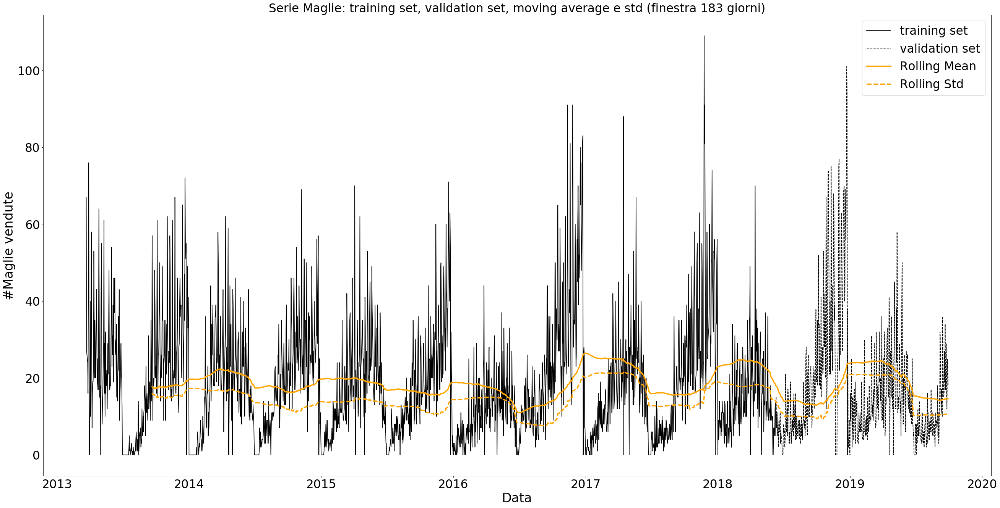

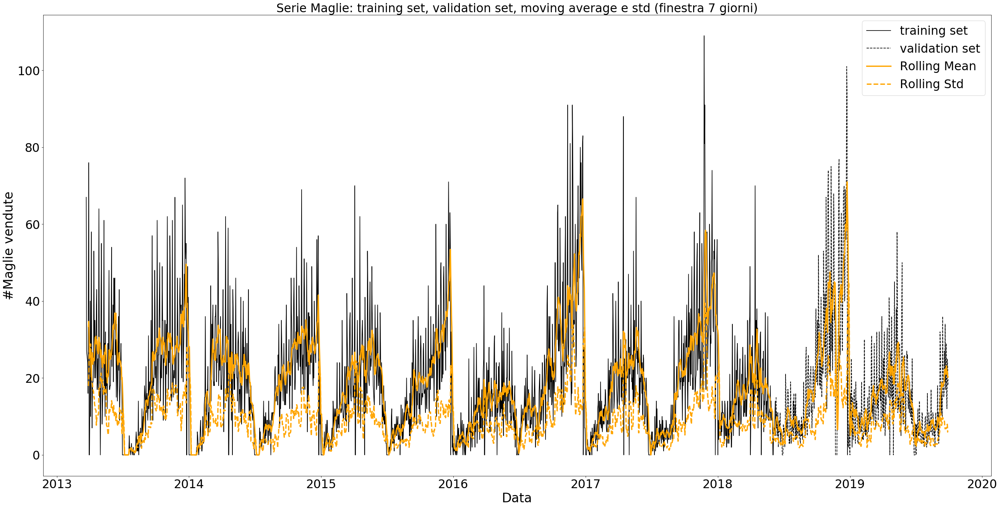

In [14]:
# plot std e media con finestra di un anno, metà anno, settimana 

for seas in seasons:

    rolmean = ts.rolling(window=seas).mean()
    rolstd = ts.rolling(window=seas).std()

    plt.figure(figsize=(40, 20), dpi=80)
    plt.title('Serie Maglie: training set, validation set, moving average e std (finestra {} giorni)'.format(seas))
    plt.ylabel('#Maglie vendute')
    plt.xlabel('Data')
    plt.plot(train, label="training set", color=TSC)
    plt.plot(valid, label="validation set", color =VSC, linestyle = '--')
    plt.plot(rolmean, color=OLC, label='Rolling Mean',  linewidth=3)
    plt.plot(rolstd, color=OLC, label='Rolling Std', linestyle = '--',  linewidth=3)
    plt.legend(loc='best')
    plt.show(block=False)

<a class='anchor' id='grafici-acf'/>

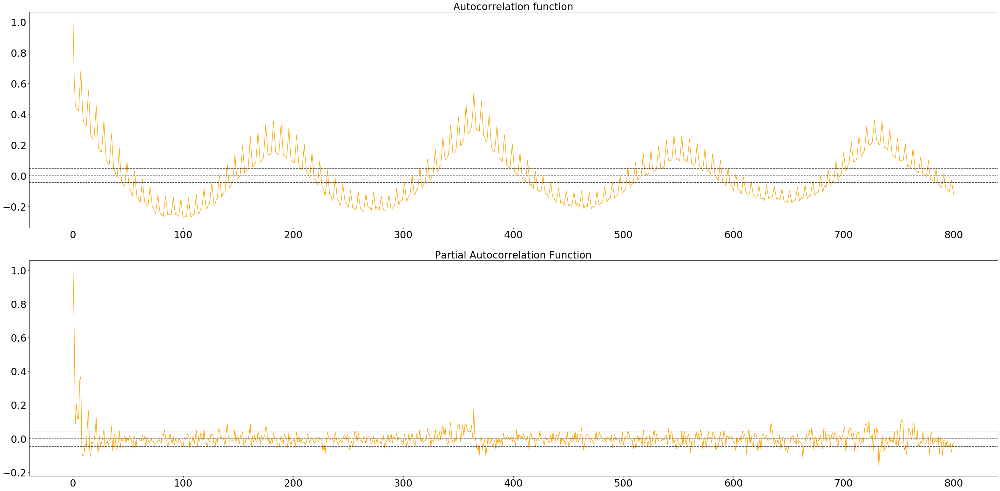

In [15]:
# plot funzioni di correlazione e autocorrelazione parziale

ac_pac_function(train, lags = 800)

Giunti a questo punto calcolo il grado di forza della stagionalità per determinare se sia necessario o meno applicare una differenziazione stagionale. Quest'ultima è consigliata solo se il grado di forza risulta maggiore di 0.64 . In questo caso otteniamo un valore di ~0.55 per una stagione di 365 giorni quindi non applichiamo alcuna differenziazione stagionale.

La forza della stagionalità di periodo 365 è: 0.5495909566239753


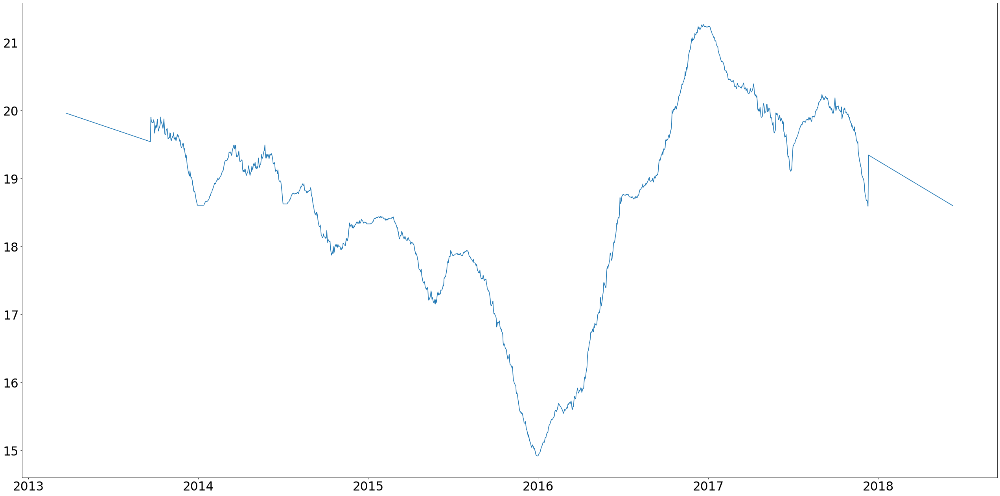

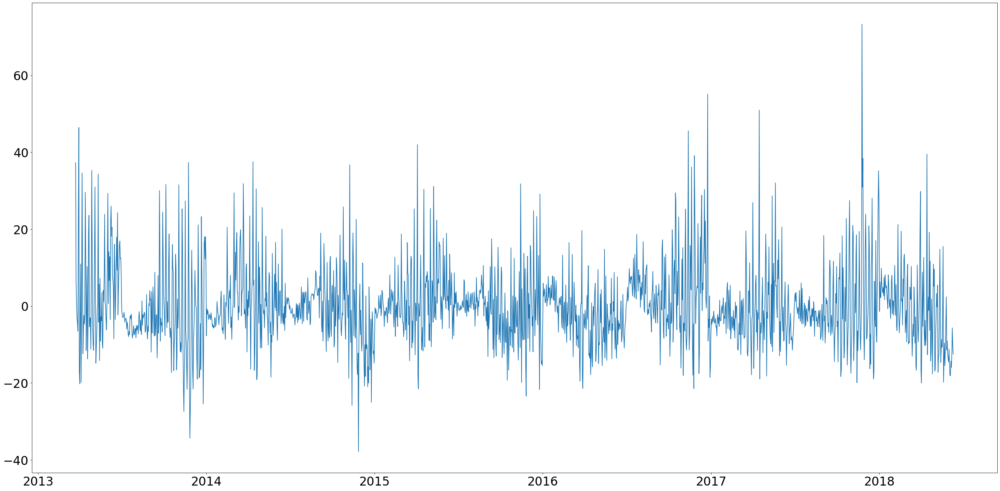

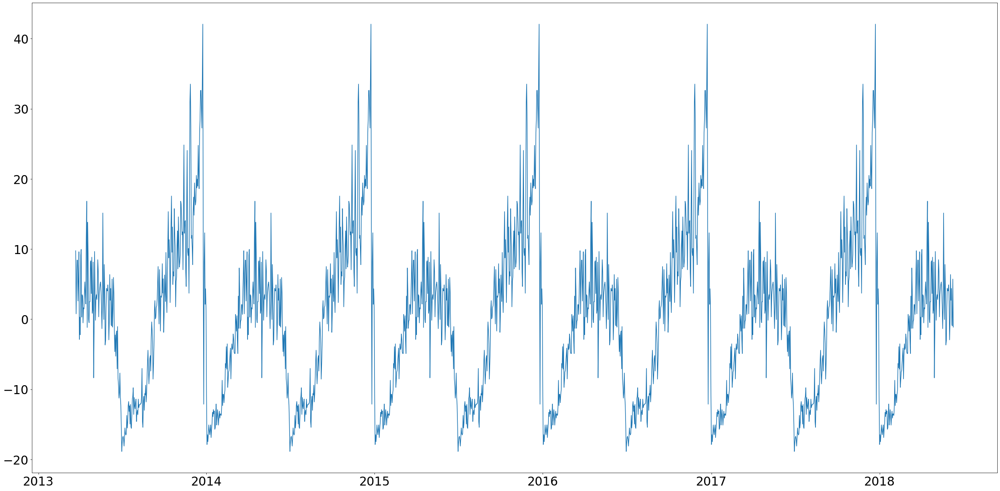

In [7]:
#%%
# Decompongo la serie
# con periodo di season giorni (year e half_year a seconda di cosa viene scelto all'inizio)

result = seasonal_decompose(train,  model = 'additive', period = season, extrapolate_trend='freq')

trend = result.trend
seasonality = result.seasonal
residuals = result.resid

# Calcolo il grado di forza della stagionalità

strength_seasonal = max(0, 1 - residuals.var()/(seasonality + residuals).var())
print('La forza della stagionalità di periodo {} è: {}'.format(season, strength_seasonal))

plt.figure(figsize=(40, 20), dpi=80)
plt.plot(trend)
plt.figure(figsize=(40, 20), dpi=80)
plt.plot(residuals)
plt.figure(figsize=(40, 20), dpi=80)
plt.plot(seasonality)

Il grado di forza calcolato è inferiore a 0.64 quindi non applichiamo alcuna differenziazione stagionale.

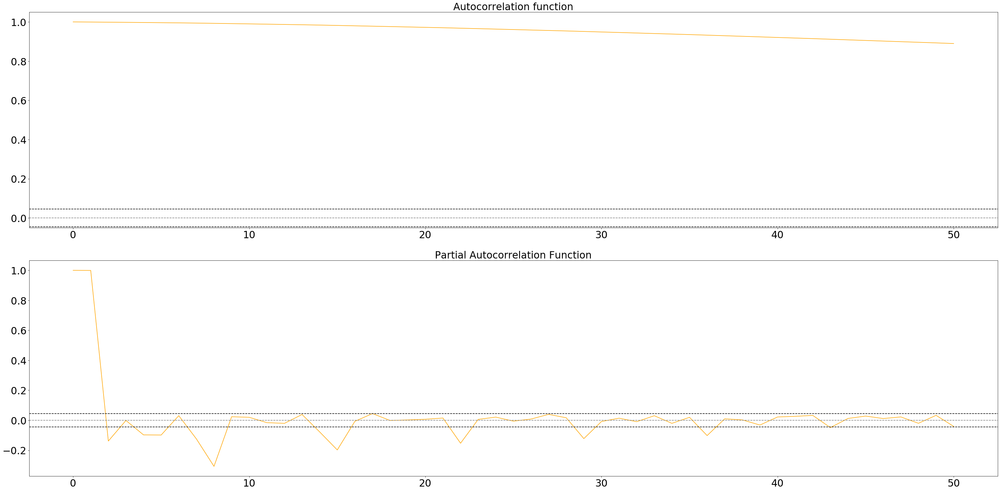

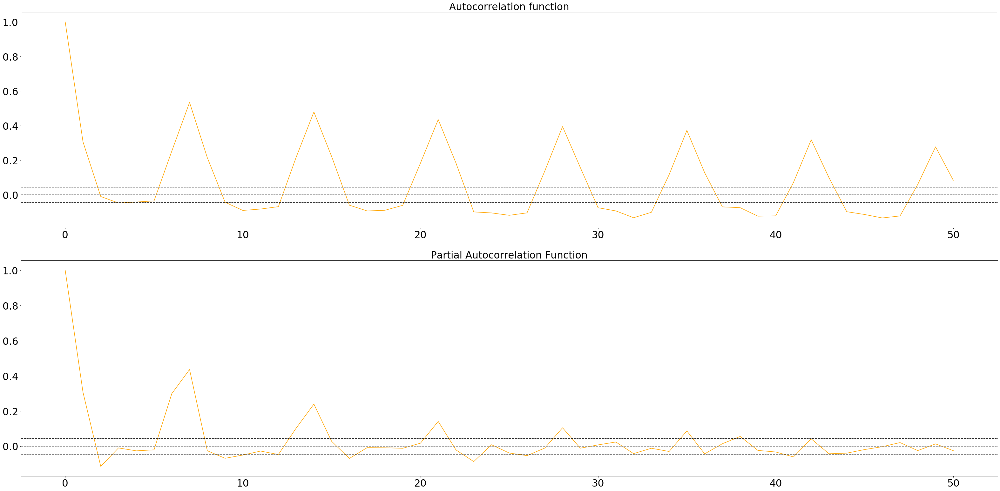

In [10]:
# Rimuovo i valori nulli

trend.dropna(inplace = True)
seasonality.dropna(inplace = True)
residuals.dropna(inplace = True)

# Verifico che non siano presenti ulteriori stagionalità nelle componenti trend e residuals

ac_pac_function(trend, lags = 50)
ac_pac_function(residuals, lags = 50)

In [11]:
# Genero tutte le combinazioni possibili di ordini (in totale sono 6 * 2 * 6 = 72)

p = q = range(0, 6)
d = range(0, 2)
pdq = list(itertools.product(p, d, q))

# Creo due variabili per confrontare i risultati delle applicazioni di ARIMA di ordini diversi e poter salvare il migliore

best = None
best_AIC = None

In [ ]:
# genero le previsioni della componente trend
# il processo per determinare gli ordini che forniscono il risultato migliore richiede molto tempo per il calcolo
# ordine 5,0,4 con stagione 183
# ordine 5,1,5 con stagione 365

for param in pdq:
    try:
        mod = ARIMA(trend, order=param)
        results = mod.fit()
        print('ARIMA{} - AIC:{}'.format(param, results.aic))
        if best is None:
            best = param
            best_AIC = results.aic
        elif results.aic < best_AIC:
            best_AIC = results.aic
            best = param
    except:
        continue

print('Gli ordini scelti per il trend sono {} con un AIC di {}'.format(best, best_AIC))

In [16]:
# Per evitare il calcolo...

best = [5, 1, 5]

## ARIMA <a class='anchor' id='ARIMA'/>

La combinazione di modelli autoregressivi e modelli di media in movimento ci permettono di ottenere il modello ARIMA. ARIMA è l'acronimo per "AutoRegressive Integrated Moving Average" e può essere scritto nella forma:

\begin{align}
 y'_{t} = c + \phi_{1}y'_{t-1} + \cdots + \phi_{p}y'_{t-p}
     + \theta_{1}\varepsilon_{t-1} + \cdots + \theta_{q}\varepsilon_{t-q} + \varepsilon_{t}
\end{align}

dove $y'_{t}$ è la serie differenziata (anche più di una volta). Per le previsioni si tengono in considerazione sia i valori di $y_t$ spostati di un certo lag sia degli errori spostati di un certo lag. In un modello ARIMA($p,d,q$):
- p è l'ordine della parte autoregressiva.
- d è il grado della differenziazione.
- q è l'ordine della parte di media in movimento.

La scelta degli ordini è un'operazione tutt'altro che banale. Nel nostro caso abbiamo cercato i modelli con gli ordini che minimizzassero la metrica AIC in modo da garantire di aver scelto il migliore in un range specificato.

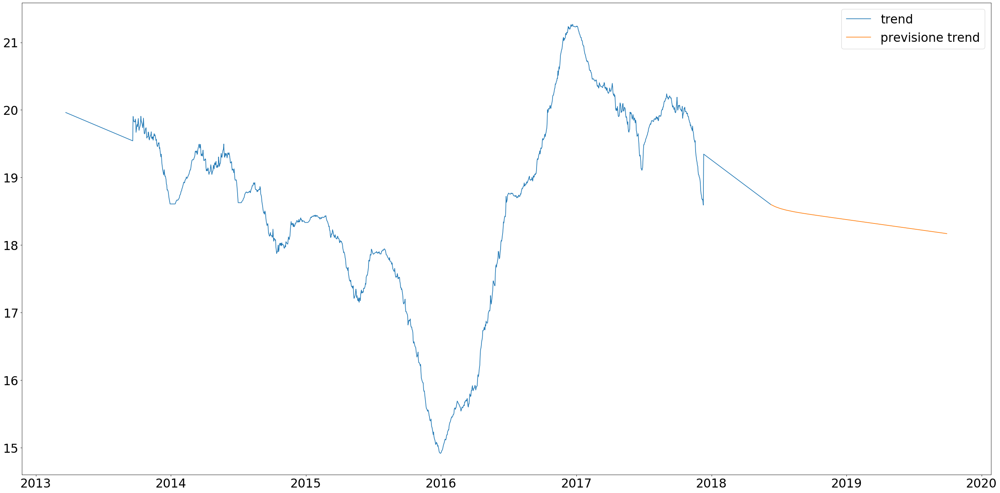

In [13]:
# Applicazione ARIMA

trend_model = ARIMA(trend, order=best)
trend_fitted = trend_model.fit()
"""fitted.summary()"""

# Se è stata applicata differenziazione (d = 1) per ritornare nella forma originale sarà necessario calcolare le somme cumulative
# aggiungendo il valore iniziale della serie da cui si è generato il modello, altrimenti rimarrà scostata di tale valore rispetto
# alle osservazioni!

trend_predictions, _, confidence_int = trend_fitted.forecast(steps = len(valid))
ts_trend_predictions = pd.Series(trend_predictions, index=pd.date_range(start=ts.index[int(len(ts)*0.8)+1], end = ts.index[int(len(ts))-1], freq='D')) 
trend_modfit = pd.Series(trend_fitted.fittedvalues, index=pd.date_range(start=ts.index[0], end=ts.index[int(len(ts) * 0.8)], freq='D'))
if best[1] == 1:
    trend_modfit[0] = trend[0]
    trend_modfit = trend_modfit.cumsum()


plt.figure(figsize=(40, 20), dpi=80)
plt.plot(trend, label='trend')
plt.plot(ts_trend_predictions, label='previsione trend')
plt.legend(loc = 'best')

In [ ]:
# genero le previsioni della componente residuals
# il processo per determinare gli ordini che forniscono il risultato migliore richiede molto tempo per il calcolo
# ordine 5,0,5 con stagione 183
# ordine 5,0,5 con stagione 365

best = None
best_AIC = None
for param in pdq:
    try:
        mod = ARIMA(residuals, order=param)
        results = mod.fit()
        print('ARIMA{} - AIC:{}'.format(param, results.aic))
        if best is None:
            best = param
            best_AIC = results.aic
        elif results.aic < best_AIC:
            best_AIC = results.aic
            best = param
    except:
        continue

print('Gli ordini scelti per i residui sono {} con un AIC di {}'.format(best, best_AIC))

In [17]:
# Per evitare il calcolo...

best = [5, 0, 5]

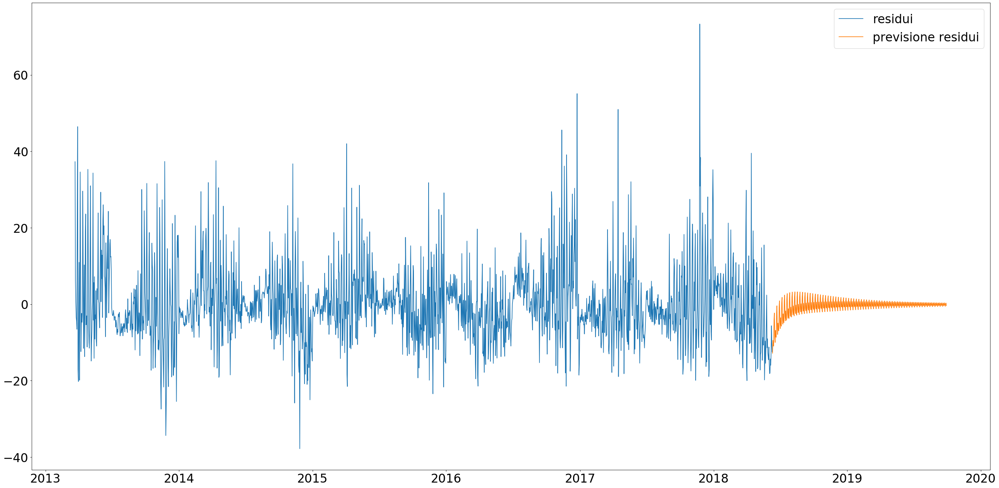

In [17]:
# Applico ARIMA

residuals_model = ARIMA(residuals, order=best)
residuals_fitted = residuals_model.fit()
"""fitted.summary()"""

# Ottengo le previsioni

residuals_predictions, _, confidence_int = residuals_fitted.forecast(steps = len(valid))
ts_residuals_predictions = pd.Series(residuals_predictions, index=pd.date_range(start=ts.index[int(len(ts)*0.8)+1], end = ts.index[int(len(ts))-1], freq='D')) 

# Se è stata applicata differenziazione (d = 1) per ritornare nella forma originale sarà necessario calcolare le somme cumulative
# aggiungendo il valore iniziale della serie da cui si è generato il modello, altrimenti rimarrà scostata di tale valore rispetto
# alle osservazioni!

residuals_modfit = pd.Series(residuals_fitted.fittedvalues, index=pd.date_range(start=ts.index[0], end=ts.index[int(len(ts) * 0.8)], freq='D'))
if best[1] == 1:
    residuals_modfit[0] = residuals[0]
    residuals_modfit = residuals_modfit.cumsum()


plt.figure(figsize=(40, 20), dpi=80)
plt.plot(residuals, label='residui')
plt.plot(ts_residuals_predictions, label='previsione residui')
plt.legend(loc = 'best')

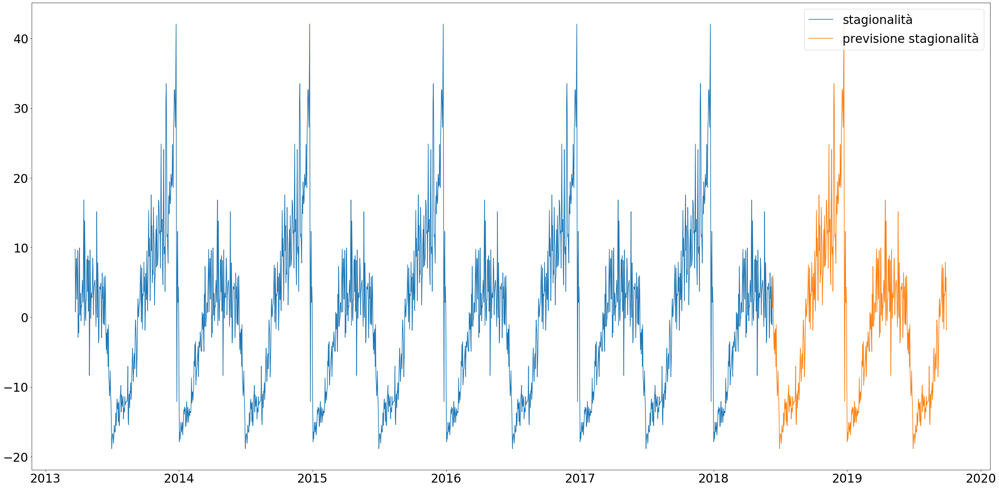

In [18]:
# genero le previsioni della componente stagionale usando il metodo seasonal naive (ricopiando le n osservazioni precedenti
# tenendo conto della stagionalità)

predictions_seasonality = []
for i in range (0, len(valid)):
    if i < season:
        predictions_seasonality.append(seasonality[len(seasonality)-season+i])
    else:
        predictions_seasonality.append(predictions_seasonality[i%season])

# produco la serie temporale dalla lista di valori usando come indice le date del validation set        

ts_predictions_seasonality = pd.Series(predictions_seasonality, index=pd.date_range(start=ts.index[int(len(ts)*0.8)+1], end = ts.index[int(len(ts))-1], freq='D'))

plt.figure(figsize=(40, 20), dpi=80)
plt.plot(seasonality, label='stagionalità')
plt.plot(ts_predictions_seasonality, label='previsione stagionalità')
plt.legend(loc='best');

2018-06-11     7.122293
2018-06-12    15.083669
2018-06-13    11.440284
2018-06-14     5.792416
2018-06-15     9.826753
Freq: D, dtype: float64
Calcoliamo  MAE=8.2124
Calcoliamo MSE: 147.3166


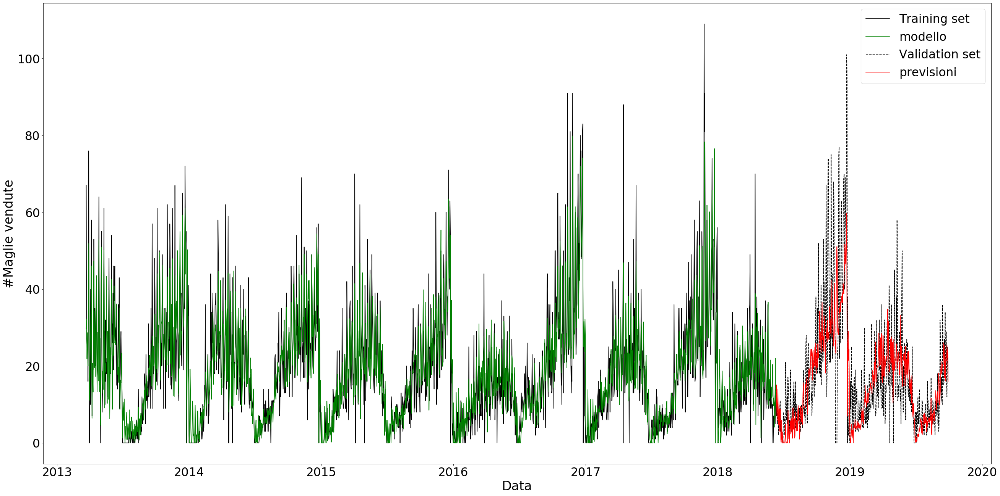

In [21]:
# Torno alla forma iniziale sommando le componenti del modello 

model = trend_modfit + residuals_modfit + seasonality

# Calcolo le previsioni (per il periodo di validazione, con cui fare il confronto
# per determinarne la bontà)

predictions = ts_residuals_predictions + ts_predictions_seasonality + ts_trend_predictions

# Arrotondo le previsioni a zero per valori negativi (in quanto non hanno senso vendite negative). In questo
# modo otterrò metriche di errore migliori!

"""
for i in range (0, len(model)):
    if model[i] < 0:
        model[i] = 0
"""

for i in range (0, len(predictions)):
    if predictions[i] < 0:
        predictions[i] = 0

# Plot del modello ARIMA con la serie per il training in scala originale

plt.figure(figsize=(40, 20), dpi=80)
plt.plot(train, label = "Training set", color = 'black')
plt.plot(model, color='green', label='modello')
plt.plot(valid, color='black', linestyle='--', label = 'Validation set')
plt.legend(loc='best');

ci = 1.96 * np.std(predictions)/np.mean(predictions)
plt.plot(predictions, color="red", label='previsioni')
plt.xlabel('Data')
plt.ylabel('#Maglie vendute')
plt.legend(loc='best')
print(predictions.head())

errore = predictions - valid
errore.dropna(inplace=True)

# Metriche di errore per verificare la bontà dei risultati

print("Calcoliamo  MAE=%.4f"%(sum(abs(errore))/len(errore)))
print('Calcoliamo MSE: %.4f'%(sum((predictions-valid)**2)/len(valid)))

## Exponential Smoothing (ETS) <a class='anchor' id='ETS'/>

Il metodo exponential smoothing utilizza medie pesate delle osservazioni passate con pesi che decadono esponenzialmente con l'avanzare nel tempo per compiere le previsioni: più recenti sono le osservazioni più viene data loro importanza (peso maggiore).

### Simple Exponential Smoothing

Il modello simple exponential smoothing richiede pochissima computazione ed è utilizzato quando l'insieme dei dati non è approssimativamente orizzontale (non presenta quindi nè trend nè stagionalità). I valori generati dall'applicazione del modello sono dati da:

\begin{align}
& \ell_{t} = \alpha y_t + (1-\alpha )\ell_{t-1} & \mbox{livello}
\end{align}

Dove $y_t$ è il valore della serie al tempo $t$ , $\ell_{t-1}$ è il valore calcolato al tempo $t-1$ , $\ell_{t}$ è il valore previsto al tempo $t$ e $\alpha$ è la costante di smoothing. Il calcolo di $\ell_{t}$ è basato sull'attribuire un peso $\alpha$ alla più recente osservazione $y_t$ e un peso $1-\alpha$ alla previsione $\ell_{t-1}$ (l'ultima calcolata).
La costante $\alpha$ è un numero compreso tra 0 e 1. Quando $\alpha = 1$, le osservazioni e la versione "smoothed" della serie coincidono mentre per valori vicini a 1 il modello dà peso maggiore alle osservazioni recenti. Quando invece $\alpha = 0$ la serie è resa "piatta" mentre per valori di $\alpha$ vicini a zero il modello tiene in considerazione la storia passata. In questa implementazione la funzione $fit()$ fornisce la configurazione migliore per applicare il modello, nello specifico decide un valore per $\alpha$ (chiamato in questo caso $smoothing\_ level$), il cui valore viene automaticamente ottimizzato se non è fornito o settato su $None$ (l'ottimizzazione è ottenuta determinando il valore che riduce al minimo la metrica SSE ossia la somma dei quadrati dei residui/errori rispetto alla serie che ci è data).

Le previsioni quindi sono ricavate dall'equazione:

\begin{align}
& \overline y_{t+h|t} = \ell_t & \mbox{previsione}
\end{align}

dove $\ell_t$ è il valore calcolato dal modello al tempo t, di conseguenza si avranno delle previsioni piatte simili al modello naive: questo metodo è quindi accettabile solo per previsioni puntuali o comunque molto brevi.

Nonostante si tratti di un metodo che ha senso se utilizzato con serie prive di trend e stagionalità abbiamo comunque deciso di ottenere le previsioni con questo modello per avere un confronto con le tecniche più avanzate di Exponential Smoothing.

MSE: 335.370095
Calcoliamo  MAE=11.4063


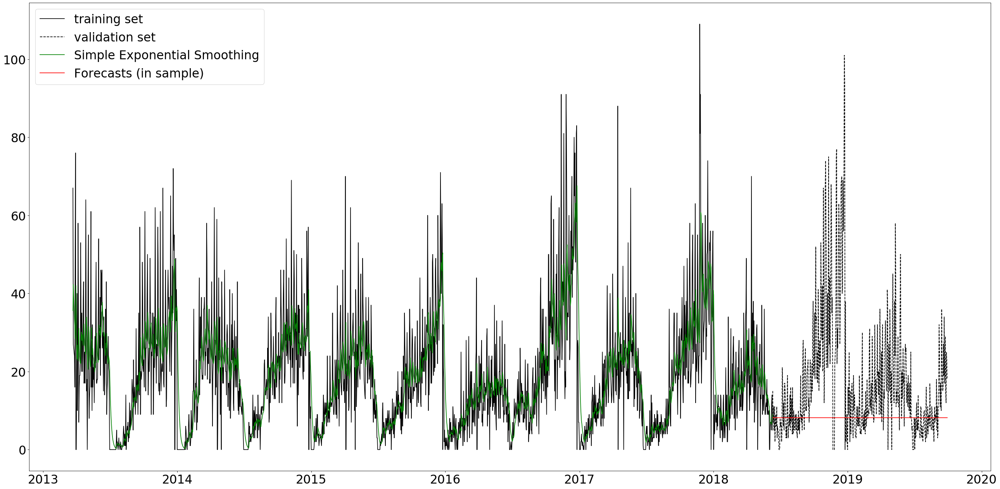

In [27]:
np.warnings.filterwarnings('ignore')

# Applico il modello simple exponential smoothing

modelv1 = SimpleExpSmoothing(train)

# fit del modello
# è possibile passare un parametro smoothing_level di tipo float per fissare una determinata alpha

fitted = modelv1.fit()

# ottengo le previsioni. Stesso periodo del validation set!

forecasted = fitted.forecast(steps = int(len(valid)))

plt.figure(figsize=(40, 20), dpi=80)
plt.plot(train, label="training set", color=TSC)
plt.plot(valid, label="validation set", color =VSC, linestyle = '--')
plt.plot(fitted.fittedvalues, label="Simple Exponential Smoothing", color=MRC)
plt.plot(forecasted, label="Forecasts (in sample)", color=FC)
plt.legend(loc='best')
plt.plot()

errore = forecasted - valid
errore.dropna(inplace=True)

mse = mean_squared_error(valid, forecasted)
print('MSE: %f' % mse)
print("Calcoliamo  MAE=%.4f"%(sum(abs(errore))/len(errore)))

### Triple Exponential Smoothing

Questo metodo è conosciuto anche come metodo "Holt-Winters". L'idea di fondo in questo metodo è quella di applicare l'exponential smoothing tenendo in considerazione oltre al "livello" (l'unica componente considerata nel caso del simple exponential smoothing) anche la stagionalità ed il trend della serie. Lo smoothing viene applicato quindi tra stagioni: il valore calcolato per il terzo punto di una stagione (diversa dalla prima ovviamente), per esempio, sarà il risultato dell'applicazione dello smoothing sui terzi punti di tutte le stagioni precedenti. La lunghezza della stagione è indicata con '$L$'.

Le componenti sono calcolate in questo modo:

\begin{align}
& \ell_x = \alpha(y_x - s_{x-L}) + (1-\alpha)(\ell_{x-1} + b_{x-1}) & \mbox{livello} \\
& b_x = \beta(\ell_x - \ell_{x-1}) + (1-\beta)b_{x-1} & \mbox{trend} \\
& s_x = \gamma(y_x - \ell_x) + (1-\gamma)s_{x-L} & \mbox{stagionalità} \\
& \overline{y}_{x+m} = \ell_x + mb_x + s_{x-L+1+(m-1)modL} & \mbox{previsione}\\
\end{align}

Come è possibile notare ora l'equazione delle previsioni è data dalla somma della componente stagionale, trend e livello. Ogni componente presa singolarmente è dotata di un proprio fattore di smoothing. 

#### Trend

Per il trend si calcola la media delle medie dei trend attraverso le stagioni con questa formula:

\begin{equation}
b_0 = \dfrac{1}{L}\left(\dfrac{y_{L+1}-y_1}{L}+\dfrac{y_{L+2}-y_2}{L}+...+\dfrac{y_{L+L}-y_L}{L}\right)
\end{equation}

#### Componente stagionale

Si calcola la media per ciascuna stagione ('$k$' è il numero di stagioni presenti nei dati):

\begin{align}
A_p = \frac{\sum_{i=1}^L y_i}{L} \, , \,\,\,\,\, p = 1, \, 2, \, \ldots, \, k \, .
\end{align}

Si dividono le osservazioni per le appropriate medie stagionali:

\begin{align}
& 1 & & 2 & & 3 & & ... & & k
& \\
& y_1/A_1 & & y_{1+L}/A_2 & & y_{1+2L}/A_3 & & ... & & y_{1+(k-1)L}/A_k \\
& \\
& y_2/A_1 & & y_{2+L}/A_2 & & y_{2+2L}/A_3 & & ... & & y_{2+(k-1)L}/A_k \\
& \\
& y_3/A_1 & & y_{3+L}/A_2 & & y_{3+2L}/A_3 & & ... & & y_{3+(k-1)L}/A_k \\
& \\
& ...
& \\
& y_L/A_1 & & y_{L+L}/A_2 & & y_{L+2L}/A_3 & & ... & & y_{L+(k-1)L}/A_k \\
\end{align}

Gli indici stagionali si ottengono calcolando la media di ciascuna riga in questo modo:

\begin{eqnarray}
I_1 & = & \left( y_1/A_1 + y_{1+L}/A_2 + y_{1+2L}/A_3 + y_{1+3L}/A_4 + y_{1+4L}/A_5 + ... + y_{1+(k-1)L}/A_k \right) / k \\
    &   &   \\
I_2 & = & \left( y_2/A_1 + y_{2+L}/A_2 + y_{2+2L}/A_3 + y_{2+3L}/A_4 + y_{2+4L}/A_5 + ... + y_{2+(k-1)L}/A_k \right) / k \\
    &   &   \\
I_3 & = & \left( y_3/A_1 + y_{3+L}/A_2 + y_{3+2L}/A_3 + y_{3+3L}/A_4 + y_{3+4L}/A_5 + ... + y_{3+(k-1)L}/A_k \right) / k \\
    &   &   \\
I_4 & = & \left( y_4/A_1 + y_{4+L}/A_2 + y_{4+2L}/A_3 + y_{4+3L}/A_4 + y_{4+4L}/A_5 + ... + y_{4+(k-1)L}/A_k \right) / k \\
    &   &   \\
    ... \\
\end{eqnarray}



MSE: 175.971549
Calcoliamo  MAE=9.0670


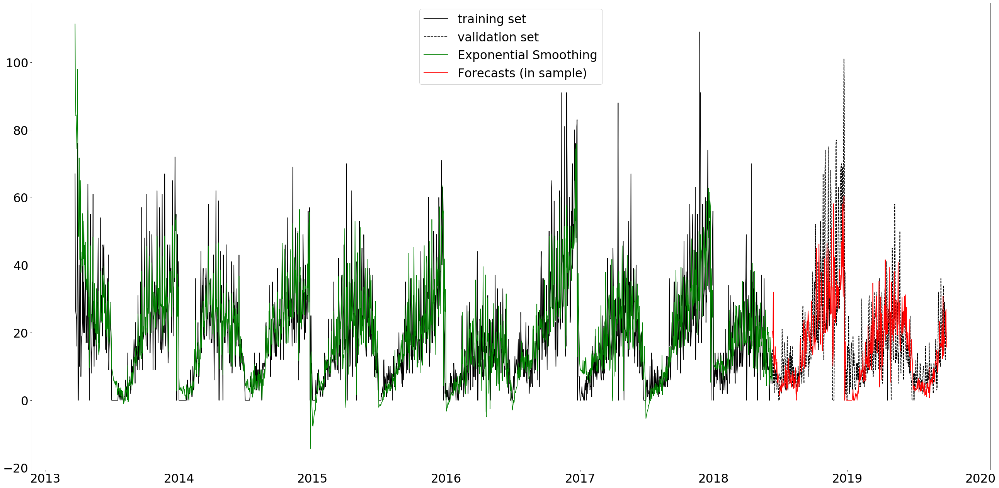

In [29]:
np.warnings.filterwarnings('ignore')

model = ExponentialSmoothing(train, seasonal="add", trend="add", seasonal_periods=year*2, damped = True)

# Fit del modello

fitted = model.fit()

# Eseguo le previsioni. Viene aggiunto il valore previsto dal simple exponential smoothing.

model_predictions = fitted.forecast(steps = int(len(valid))) + forecasted

# tolgo i valori negativi dalle previsioni

for i in range(1, len(model_predictions)):
    if model_predictions[i] < 0:
        model_predictions[i] = 0

plt.figure(figsize=(40, 20), dpi=80)
plt.plot(train, label="training set", color=TSC)
plt.plot(valid, label="validation set", color =VSC, linestyle = '--')
plt.plot(fitted.fittedvalues, label="Exponential Smoothing", color=MRC)
plt.plot(model_predictions, label="Forecasts (in sample)", color=FC)
plt.legend(loc='best')
plt.plot()

errore = model_predictions - valid
errore.dropna(inplace=True)

mse = mean_squared_error(valid, model_predictions)
print('MSE: %f' % mse)
print("Calcoliamo  MAE=%.4f"%(sum(abs(errore))/len(errore)))

### Exponential Smoothing con decomposizione

Nel tentativo di migliorare ulteriormente i risultati ottenuti con il Triple Exponential Smoothing applicato direttamente sui dati forniti abbiamo provato a seguire un percorso diverso:
- decomposizione della serie nelle sue componenti (residui, stagionalità, trend)
- applicazione di ETS alle componenti singole (specificando il tipo di componente passato a ETS, quindi nessun trend per la componente stagionale e viceversa)
- per i residui abbiamo utilizzato ARIMA in quanto ETS non forniva buoni risultati (in quanto questa componente è per definizione priva sia di trend che di stagionalità)

Il risultato finale è stato ottenuto sommando i risultati delle previsioni sulle singole componenti ed è migliore rispetto a quello ottenuto dall'applicazione diretta di ETS.

MSE: 158.049831
Calcoliamo  MAE=8.4453


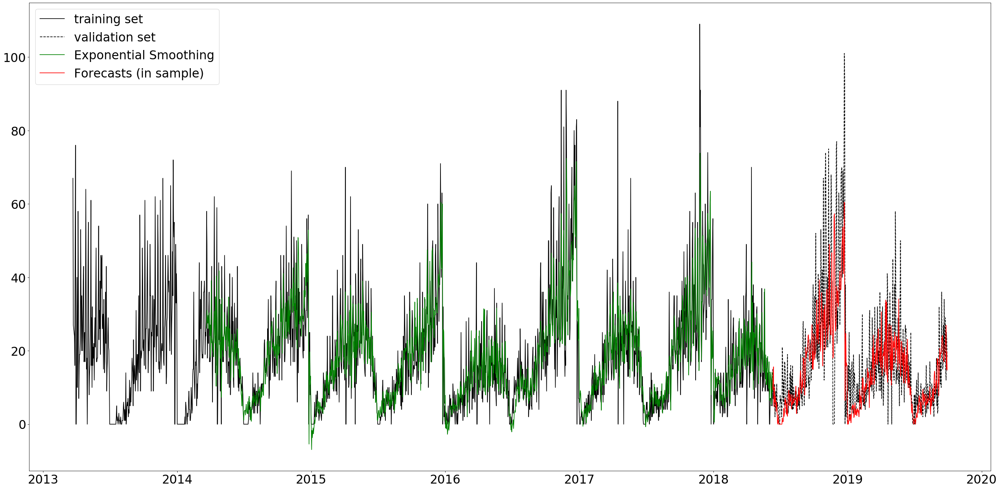

In [12]:
# %%
# Proviamo a usare ets in maniera scomposta sulle componenti e poi
# sommare i risultati.

np.warnings.filterwarnings('ignore')
decomposition = seasonal_decompose(train, period=year, two_sided=False)

trend = decomposition.trend
seasonal = decomposition.seasonal
residual = decomposition.resid

trend.dropna(inplace=True)
seasonal.dropna(inplace=True)
residual.dropna(inplace=True)

# Creiamo dei modelli per trend e seasonal + USO ARIMA PER I RESIDUAL VISTO CHE SONO UNA COMPONENTE STAZIONARIA
trend_model = ExponentialSmoothing(trend, trend="add", damped = True, seasonal=None)
seasonal_model = ExponentialSmoothing(seasonal, trend=None, seasonal='add', seasonal_periods=year)

# ARIMA SU RESIDUAL (PER FORZA)
residual_model = ARIMA(residual, order=(1, 0, 6))

# fit model
trend_fitted    = trend_model.fit()
seasonal_fitted = seasonal_model.fit()
residual_fitted = residual_model.fit()

# make prediction. Stesso periodo del validation set!    
trend_model_predictions = trend_fitted.forecast(steps = int(len(valid)))
seasonal_model_predictions = seasonal_fitted.forecast(steps = int(len(valid)))
residual_model_predictions, _, _ = residual_fitted.forecast(steps = int(len(valid)))

#Sommo i modelli
model_predictions = trend_model_predictions \
                    + seasonal_model_predictions \
                    + residual_model_predictions

model_predictions.dropna(inplace=True)

for i in range(1, len(model_predictions)):
    if model_predictions[i] < 0:
        model_predictions[i] = 0

# annulliamo i valori negativi

plt.figure(figsize=(40, 20), dpi=80)
plt.plot(train, label="training set", color=TSC)
plt.plot(valid, label="validation set", color =VSC, linestyle = '--')
plt.plot(trend_fitted.fittedvalues + 
         seasonal_fitted.fittedvalues + 
         residual_fitted.fittedvalues, label="Exponential Smoothing", color=MRC)
plt.plot(model_predictions, label="Forecasts (in sample)", color=FC)
plt.legend(loc='best')
plt.plot()


errore = model_predictions - valid
errore.dropna(inplace=True)

mse = mean_squared_error(valid, model_predictions)
print('MSE: %f' % mse)
print("Calcoliamo  MAE=%.4f"%(sum(abs(errore))/len(errore)))

# Modelli per serie con stagionalità multiple <a class='anchor' id='stagionalità_multiple'/>

Le serie temporali ad elevata frequenza presentano spesso delle stagionalità complesse. Ad esempio, i dati con frequenza giornaliera possono avere stagionalità settimanale ed annuale; mentre i dati con frequenza oraria hanno di solito stagionalità giornaliera, settimanale ed annuale. Anche i dati con frequenza settimanale possono essere difficili da trattare in quanto hanno in genere una stagionalità annuale pari a circa $52.179$, ovvero $365.25 / 7$.

Tuttavia, la maggior parte dei modelli che abbiamo esaminato finora non è in grado di affrontare queste stagionalità complesse. Ad esempio, il modello SARIMAX può gestire un solo tipo di stagionalità e, in genere, si presuppone che questa assuma valori interi.

Per questi motivi, i modelli per serie con stagionalità multiple stanno diventando sempre più comuni nell'analisi dei dati ad alta frequenza. Tali modelli devono quindi essere in grado di gestire più tipi di stagionalità contemporaneamente, consentendo di specificare tutti quelli che potrebbero essere rilevanti. Infatti, non si vuole necessariamente includere tutti i tipi di stagionalità, ma solo quelli che si pensa possano essere presenti nei dati a seguito delle analisi di stagionalità. Infine, i modelli devono essere anche abbastanza flessibili nel gestire i valori di stagionalità non interi.

## Modello TBATS

TBATS è un modello alternativo sviluppato da De Livera, Hyndman e Snyder (2011) che incorpora trasformazioni Box-Cox, serie di Fourier con coefficienti variabili nel tempo e correzione degli errori tramite modello ARMA. TBATS è stato introdotto per consentire la previsione di serie temporali con stagionalità complesse (ad es. stagionalità multiple, stagionalità ad alta frequenza, stagionalità non intere), le quali non possono essere gestite utilizzando i modelli di previsione esistenti.

Essendo un framework di modellazione automatizzato, ci possono essere casi in cui TBATS fornisce risultati scarsi; ma, di contro, può comunque essere un approccio molto utile in alcune circostanze.

### Vantaggi e svantaggi

La serie di Fourier, ovvero una serie di termini seno e coseno con una determinata frequenza, può approssimare qualsiasi funzione periodica. Tale approccio è detto regressione armonica dinamica. Si possono quindi usare i termini della serie di Fourier anche per modellare la stagionalità; nel caso di stagionalità multiple sarà necessario aggiungere termini di Fourier per ogni periodo stagionale.

Un vantaggio dei modelli TBATS è che la stagionalità può cambiare lentamente nel tempo, a differenza della regressione armonica dinamica in cui i relativi termini costringono le stagionalità a ripetersi periodicamente senza cambiare. Uno svantaggio dei modelli TBATS, tuttavia, è che possono essere lenti da stimare, soprattutto con serie temporali lunghe.

### Implementazione

Il nome del modello è un acronimo delle sue funzionalità chiave, ovvero:
- Trigonometric seasonality.
- Box-Cox transformation.
- ARMA errors.
- Trend and Seasonal components.

Il modello TBATS affonda le sue radici nei metodi di exponential smoothing e può essere descritto dalle seguenti equazioni:
![Equazioni del modello TBATS](https://miro.medium.com/max/805/1*yfruZnSYsNt1X1uyag46eQ.png "Equazioni del modello TBATS")

La sua implementazione prevede quindi che ogni stagionalità venga modellata da una rappresentazione trigonometrica basata sulla serie di Fourier. Uno dei principali vantaggi di questo approccio è la capacità di modellare periodi stagionali aventi lunghezze non intere. Ad esempio, data una serie di osservazioni giornaliere, è possibile modellare gli anni bisestili usando un periodo stagionale di lunghezza pari a $365.25$.

TBATS sceglie il modello finale prendendo in considerazione varie alternative. In particolare, TBATS prende in considerazione i modelli:
- Con e senza trasformazione Box-Cox.
- Con e senza Trend.
- Con e senza processo ARMA (utilizzato per modellare i residui).
- Con varie quantità di termini di Fourier (utilizzati per modellare i vari periodi stagionali).

Il modello finale verrà poi scelto utilizzando il criterio d'informazione di Akaike (AIC).

## Dati di un negozio di abbigliamento

### Analisi di stazionarietà e stagionalità

Una volta caricati i dati giornalieri di vendita di un negozio di abbigliamento per alcune categorie di vestito, è stato possibile analizzare i [grafici](#grafico-maglie) delle varie serie temporali.

In [4]:
import datetime as dt
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller, acf, pacf
import numpy as np

# imposto i parametri comuni a tutti i grafici
SMALL_SIZE = 28
MEDIUM_SIZE = 30
BIGGER_SIZE = 32
plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

# preparo un indice di tipo datetime
dateparse = lambda dates: dt.datetime.strptime(dates, '%Y-%m-%d')

# leggo le serie temporali nel file csv (MAGLIE, CAMICIE, GONNE, PANTALONI, VESTITI, GIACCHE)
data = pd.read_csv('./datasets/Whole period.csv', index_col=0, date_parser=dateparse)

# analizzo la serie temporale delle MAGLIE (per le altre il procedimento sarà analogo)
ts = data['MAGLIE']

L'analisi di stazionarietà è stata fatta eseguendo il test Dickey-Fuller, a seguito del quale si può notare che il valore Test Statistic è minore dell'1% dei valori critici. Si può quindi dire con il 99% di confidenza che la serie temporale è stazionaria.

L'analisi di stagionalità, invece, è stata fatta prima guardando il [grafico](#grafico-decomposizione) della componente stagionale dei dati (che si ricava dalla decomposizione), in cui si può notare chiaramente una componente stagionale annuale.

Poi è stata fatta un'analisi più approfondita della stagionalità guardando i [grafici](#grafici-acf) di autocorrelazione e autocorrelazione parziale, nei quali si possono osservare una componente stagionale settimanale e una componente stagionale semestrale. Sono infatti presenti dei picchi in corrispondenza dei multipli di 7 e in corrispondenza del valore 183.

In [5]:
# test Dickey-Fuller
print('Results of Dickey-Fuller Test for', ts.name, '\n')
dftest = adfuller(ts, autolag='AIC')
dfoutput = pd.Series(dftest[0:4], index=['Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used'])
for key, value in dftest[4].items():
    dfoutput['Critical Value (%s)' % key] = value
print(dfoutput)

# decomposizione
decomposition = seasonal_decompose(ts, period=365)
trend = decomposition.trend
seasonal = decomposition.seasonal
residual = decomposition.resid

Results of Dickey-Fuller Test for MAGLIE 

Test Statistic                -6.067962e+00
p-value                        1.169371e-07
#Lags Used                     2.200000e+01
Number of Observations Used    2.359000e+03
Critical Value (1%)           -3.433125e+00
Critical Value (5%)           -2.862766e+00
Critical Value (10%)          -2.567423e+00
dtype: float64


### Applicazione del modello TBATS

Dalla sezione precedente si è visto che i dati contengono osservazioni giornaliere e che presentano periodi stagionali annuali, settimanali e semestrali. Questo significa che abbiamo a che fare con serie temporali aventi stagionalità multiple. In particolare, una di queste stagionalità risulta essere molto lunga in quanto contiene 365 osservazioni (366 negli anni bisestili). Si può quindi notare che la durata della stagione annuale non potrà essere rappresentata da un numero intero; e infatti essa sarà pari a $365.25$, proprio per tenere conto degli anni bisestili.

La possibilità di trattare stagionalità lunghe e di poter specificare periodi stagionali di lunghezza non intera sono caratteristiche per cui TBATS è stato progettato e che quindi è in grado di gestire. Per iniziare a fare previsioni si deve installare il pacchetto [tbats](https://github.com/intive-DataScience/tbats) e adattare il modello ai dati desiderati. L'unica cosa che si deve fornire manualmente sono le lunghezze dei periodi stagionali. Si è anche deciso di considerare un set di train comprendente l'80% dei valori osservati per calcolare l'accuratezza del modello confrontando le sue previsioni con il set di test.

Use Box-Cox: False
Use trend: True
Use damped trend: True
Seasonal periods: [  7.    182.625 365.25 ]
Seasonal harmonics [ 3 15  7]
ARMA errors (p, q): (0, 0)
Smoothing (Alpha): 0.209073
Trend (Beta): -0.031207
Damping Parameter (Phi): 0.800000
Seasonal Parameters (Gamma): [-4.93523982e-05 -3.55048318e-04 -1.63929590e-03  1.26037800e-04
  1.30099707e-04  2.23326235e-03]
AR coefficients []
MA coefficients []
Seed vector [ 4.16860460e+01 -1.95093504e+00  6.27999803e+00  4.41918321e+00
  1.89362508e+00 -7.39805184e-01  7.10356797e-01  2.19822945e-01
  3.92840141e-02  1.02155142e+00 -5.82399350e-01  1.22876098e+00
 -1.45451283e+00  1.35446401e+00 -6.89652407e-01  1.33309361e+00
 -4.31445858e-01  2.46785898e-01 -2.65750377e-01  6.72369510e-02
 -3.36593349e-01  2.64385811e-01 -1.89918072e-01  5.58774949e+00
 -2.00192038e+00  1.12575163e+00 -1.83850213e+00  6.85436558e-01
 -1.27588750e+00  2.36117694e-02  2.39068942e-02  2.84777558e-01
  1.01675744e-02 -1.48344879e-01  4.53854640e-01 -1.22894

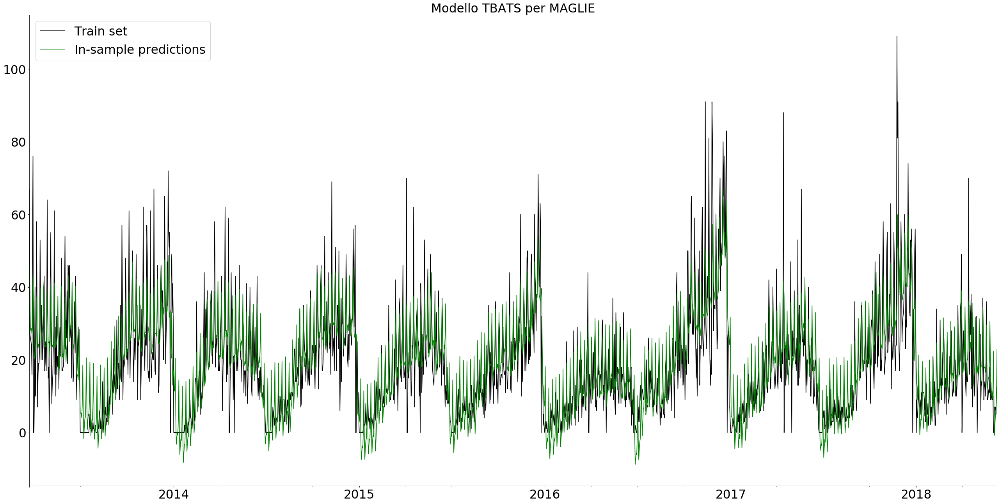

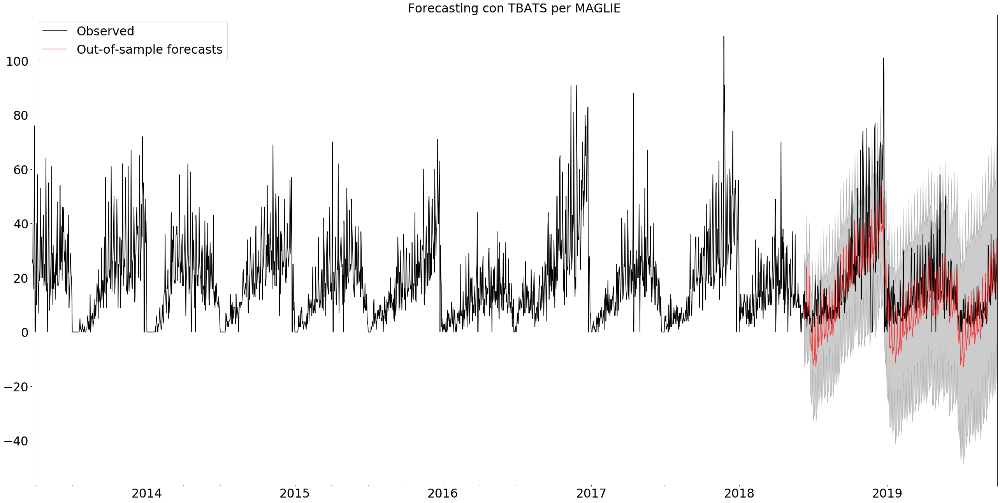

MSE=157.9947
MAE=9.2032


In [5]:
from tbats import TBATS


def tbats_model(timeseries, train_length, s, slow=True):
    """
    Previsioni con il modello TBATS

    Parameters
    ----------
    timeseries : Series
        la serie temporale.
    train_length : int
        la lunghezza del set di train (in rapporto alla serie completa).
    s : list
        l'array dei periodi stagionali.
    slow : bool
        se False velocizza il processo di scelta del modello finale (di default è True).

    Returns
    -------
    None.

    """
    # controllo se i dati sono settimanali o giornalieri
    if s.count(52) == 1:
        f = 'W-MON'
    else:
        f = 'D'
    
    # creo il set di train
    train = timeseries[pd.date_range(start=timeseries.index[0], end=timeseries.index[int(len(timeseries) * train_length)-1], freq=f)]

    # adatto il modello ai dati
    if slow:
        estimator_slow = TBATS(seasonal_periods=s)
        model = estimator_slow.fit(train)
    else:
        estimator = TBATS(
            seasonal_periods=s,
            use_arma_errors=False,  # shall try only models without ARMA
            use_box_cox=False       # will not use Box-Cox
        )
        model = estimator.fit(train)
    
    # stampo i parametri del modello
    print(model.summary())
    
    # predizioni in-sample (model.y_hat = train - model.resid)
    preds = model.y_hat
    tbats_dates = pd.date_range(start=timeseries.index[0], end=timeseries.index[len(train)-1], freq=f)
    tbats_ts = pd.Series(preds, index=tbats_dates)
    
    # predizioni out-of-sample
    fcast, conf_int = model.forecast(steps=len(timeseries)-len(train), confidence_level=0.95)
    fcast_dates = pd.date_range(start=timeseries.index[len(train)], periods=len(timeseries)-len(train), freq=f)
    ts_fcast = pd.Series(fcast, index=fcast_dates)
    ts_ci_min = pd.Series(conf_int['lower_bound'], index=fcast_dates)
    ts_ci_max = pd.Series(conf_int['upper_bound'], index=fcast_dates)
    
    # grafico del modello
    plt.figure(figsize=(40, 20), dpi=80)
    plt.title('Modello TBATS per {}'.format(timeseries.name))
    ax = train.plot(label='Train set', color='black')
    tbats_ts.plot(ax=ax, label='In-sample predictions', color='green')
    plt.legend()
    plt.show()
    
    # grafico delle previsioni
    plt.figure(figsize=(40, 20), dpi=80)
    plt.title('Forecasting con TBATS per {}'.format(timeseries.name))
    ax = timeseries.plot(label='Observed', color='black')
    ts_fcast.plot(ax=ax, label='Out-of-sample forecasts', alpha=.7, color='red')
    ax.fill_between(fcast_dates, ts_ci_min, ts_ci_max, color='k', alpha=.2)
    plt.legend()
    plt.show()
    
    # metriche di errore
    errore = ts_fcast - timeseries
    errore.dropna(inplace=True)
    print('MSE=%.4f'%(errore ** 2).mean())
    print('MAE=%.4f'%(abs(errore)).mean())


# modello TBATS con stagionalità settimanale, annuale e semestrale
tbats_model(ts, 0.8, [7, 365.25, 182.625], slow=False)

TBATS sembra aver fatto un buon lavoro nel modellare gli effetti stagionali. Infatti, guardando i parametri del modello, si scopre che sono stati utilizzati 3 termini di Fourier per modellare la stagionalità settimanale, 15 termini di Fourier per modellare la stagionalità semestrale e 7 termini di Fourier per modellare la stagionalità annuale. Inoltre si fa notare che, per limitare i tempi di computazione, è stato scelto di non utilizzare la trasformazione Box-Cox e di non utilizzare il processo ARMA per modellare i residui.

### Modello SARIMAX con stagionalità settimanale

Confrontiamo ora TBATS con un altro metodo ampiamente utilizzato e conosciuto che ha dimostrato di fornire soluzioni all'avanguardia per la previsione delle serie temporali; stiamo parlando di SARIMAX. Sfortunatamente però esso presenta due grandi svantaggi:
- Può modellare un solo effetto stagionale.
- La durata della stagione non deve essere troppo lunga.

Ignoreremo quindi la stagionalità annuale e semestrale per concentrarci sulla modellazione di quella settimanale. Inoltre, il modello SARIMAX verrà costruito usando il metodo di selezione automatica degli ordini del pacchetto [pmdarima](http://alkaline-ml.com/pmdarima/modules/generated/pmdarima.arima.auto_arima.html).

                                      SARIMAX Results                                      
Dep. Variable:                                   y   No. Observations:                 1905
Model:             SARIMAX(1, 0, 2)x(1, 0, [1], 7)   Log Likelihood               -6976.540
Date:                             Wed, 12 Aug 2020   AIC                          13967.079
Time:                                     14:28:04   BIC                          14005.945
Sample:                                          0   HQIC                         13981.385
                                            - 1905                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0701      0.043      1.637      0.102      -0.014       0.154
ar.L1          0.9466      

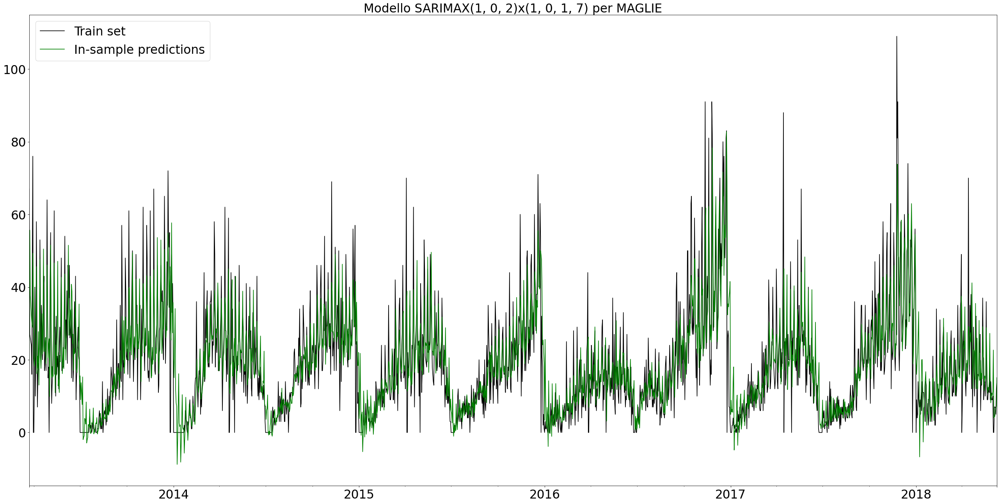

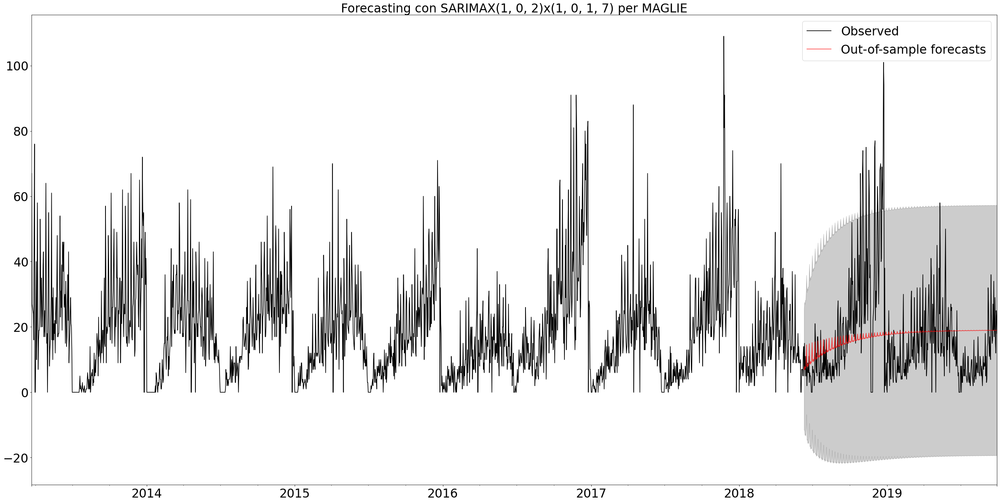

MSE=244.3164
MAE=10.9839


In [3]:
from pmdarima import model_selection
import pmdarima as pm


def sarimax_pmdarima(timeseries, train_length, m):
    """
    Previsioni con il modello SARIMAX e selezione automatica degli ordini

    Parameters
    ----------
    timeseries : Series
        la serie temporale.
    train_length : int
        la lunghezza del set di train (in rapporto alla serie completa).
    m : int
        il periodo stagionale.

    Returns
    -------
    tuple
        (order, seasonal_order)

    """
    # creo i set di train e di test
    train, test = model_selection.train_test_split(timeseries, train_size=train_length)

    # scelgo e adatto il modello ai dati
    model = pm.auto_arima(train, seasonal=True, m=m, suppress_warnings=True, trace=False,
                          start_p=1, start_q=1, max_p=2, max_q=2, start_P=1, start_Q=1, max_P=2, max_Q=2)
    
    # stampo i parametri del modello
    print(model.summary())
    
    # predizioni in-sample
    preds = model.predict_in_sample(end=len(train)-1)
    sarimax_dates = pd.date_range(start=timeseries.index[0], end=timeseries.index[len(train)-1], freq='D')
    sarimax_ts = pd.Series(preds, index=sarimax_dates)
    
    # predizioni out-of-sample
    fcast, conf_int = model.predict(n_periods=test.shape[0], return_conf_int=True)
    fcast_dates = pd.date_range(start=timeseries.index[len(train)], periods=len(timeseries)-len(train), freq='D')
    ts_fcast = pd.Series(fcast, index=fcast_dates)
    ts_ci_min = pd.Series(conf_int[:, 0], index=fcast_dates)
    ts_ci_max = pd.Series(conf_int[:, 1], index=fcast_dates)
    
    # grafico del modello
    plt.figure(figsize=(40, 20), dpi=80)
    plt.title('Modello SARIMAX{}x{} per {}'.format(model.order, model.seasonal_order, timeseries.name))
    ax = train.plot(label='Train set', color='black')
    sarimax_ts.plot(ax=ax, label='In-sample predictions', color='green')
    plt.legend()
    plt.show()
     
    # grafico delle previsioni
    plt.figure(figsize=(40, 20), dpi=80)
    plt.title('Forecasting con SARIMAX{}x{} per {}'.format(model.order, model.seasonal_order, timeseries.name))
    ax = timeseries.plot(label='Observed', color='black')
    ts_fcast.plot(ax=ax, label='Out-of-sample forecasts', alpha=.7, color='red')
    ax.fill_between(fcast_dates, ts_ci_min, ts_ci_max, color='k', alpha=.2)
    plt.legend()
    plt.show()
    
    # metriche di errore
    errore = ts_fcast - timeseries
    errore.dropna(inplace=True)
    print('MSE=%.4f'%(errore ** 2).mean())
    print('MAE=%.4f'%(abs(errore)).mean())
    
    return (model.order, model.seasonal_order)


# modello SARIMAX con stagionalità settimanale (ignoro quella semestrale e annuale)
(o, so) = sarimax_pmdarima(ts, 0.8, 7)

Il modello scelto è un SARIMAX(1,0,2)x(1,0,1,7). Come previsto, sia la stagionalità annuale che quella semestrale non sono state modellate. Infatti, confrontando le previsioni con il set di test si può notare che i risultati sono molto più scandenti rispetto a quelli di TBATS.

### Aggregazione settimanale dei dati tramite media

Dato che SARIMAX non è adatto per modellare stagionalità lunghe si è deciso di fare un'aggregazione settimanale dei dati tramite media. Così facendo la lunghezza della stagionalità annuale passa da 365 a 52. Usando gli stessi ordini trovati precedentemente, è stato costruito un altro modello SARIMAX; tuttavia questa volta ci si è concentrati sulla modellazione della stagionalità annuale. Confrontando le previsioni con il set di test si può notare che il modello fornisce dei risultati migliori rispetto a quelli che si erano ottenuti nell'analisi precedente, riuscendo a modellare in maniera soddisfacente la stagionalità annuale e a seguire quindi abbastanza fedelmente l'andamento della serie.

                                       SARIMAX Results                                       
Dep. Variable:     MAGLIE (aggregazione settimanale)   No. Observations:                  272
Model:              SARIMAX(1, 0, 2)x(1, 0, [1], 52)   Log Likelihood                -829.142
Date:                               Wed, 12 Aug 2020   AIC                           1672.285
Time:                                       14:28:32   BIC                           1697.525
Sample:                                   03-25-2013   HQIC                          1682.418
                                        - 06-04-2018                                         
Covariance Type:                                 opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.3441      0.273      1.263      0.207      -0.190       0.878
ar.L1      

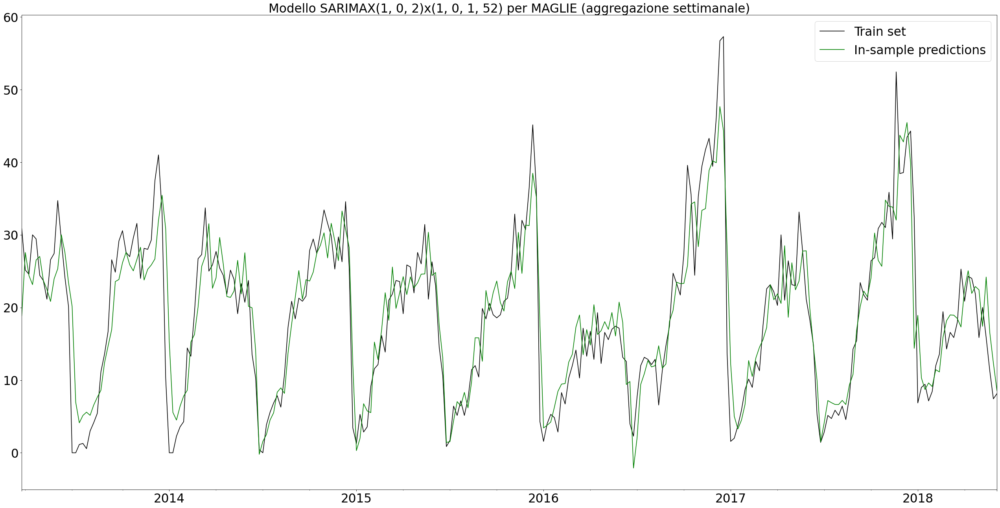

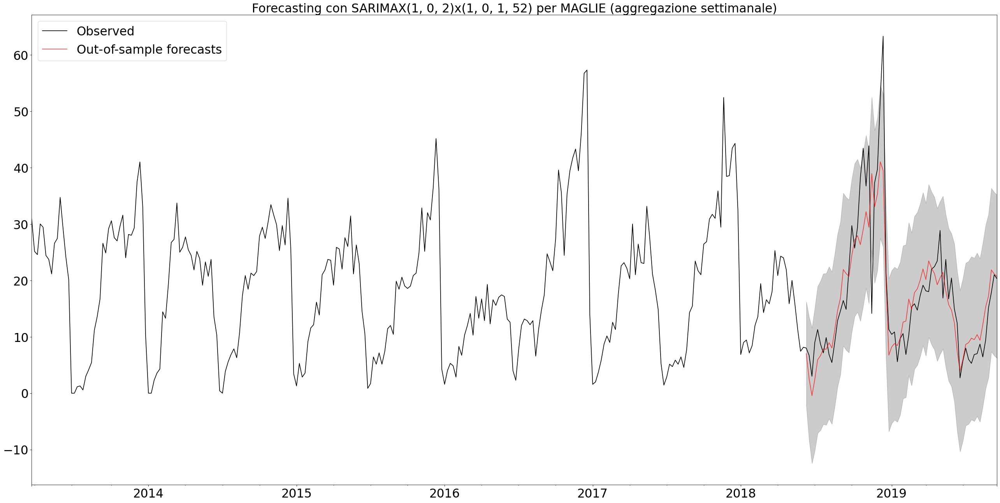

MSE=39.5972
MAE=4.2767


In [4]:
import warnings
import statsmodels.tsa.api as smt


def sarimax_statsmodels(timeseries, train_length, o, so):
    """
    Previsioni con il modello SARIMAX

    Parameters
    ----------
    timeseries : Series
        la serie temporale.
    train_length : int
        la lunghezza del set di train (in rapporto alla serie completa).
    o : iterable
        order del modello SARIMAX (per statsmodels).
    so : iterable
        seasonal_order del modello SARIMAX (per statsmodels).

    Returns
    -------
    None.

    """
    
    # controllo se i dati sono settimanali o giornalieri
    if so[3] == 52:
        f = 'W-MON'
    else:
        f = 'D'
    
    # creo il set di train
    train = timeseries[pd.date_range(start=timeseries.index[0], end=timeseries.index[int(len(timeseries) * train_length)-1], freq=f)]

    # adatto il modello ai dati
    warnings.filterwarnings("ignore")
    model = smt.SARIMAX(train, order=o, seasonal_order=so, trend='c').fit()
    
    # stampo i parametri del modello
    print(model.summary())
    
    # predizioni in-sample
    sarimax_mod = model.get_prediction(end=len(train)-1, dynamic=False)
    sarimax_dates = pd.date_range(start=timeseries.index[0], end=timeseries.index[len(train)-1], freq=f)
    sarimax_ts = pd.Series(sarimax_mod.predicted_mean, index=sarimax_dates)
    
    # predizioni out-of-sample
    fcast = model.get_forecast(steps=len(timeseries)-len(train))
    fcast_ci = fcast.conf_int()
    fcast_dates = pd.date_range(start=timeseries.index[len(train)], periods=len(timeseries)-len(train), freq=f)
    ts_fcast = pd.Series(fcast.predicted_mean, index=fcast_dates)
    
    # grafico del modello
    plt.figure(figsize=(40, 20), dpi=80)
    plt.title('Modello SARIMAX{}x{} per {}'.format(o, so, timeseries.name))
    ax = train.plot(label='Train set', color='black')
    sarimax_ts.plot(ax=ax, label='In-sample predictions', color='green')
    plt.legend()
    plt.show()
    
    # grafico delle previsioni
    plt.figure(figsize=(40, 20), dpi=80)
    plt.title('Forecasting con SARIMAX{}x{} per {}'.format(o, so, timeseries.name))
    ax = timeseries.plot(label='Observed', color='black')
    ts_fcast.plot(ax=ax, label='Out-of-sample forecasts', alpha=.7, color='red')
    ax.fill_between(fcast_dates, fcast_ci['lower '+timeseries.name], fcast_ci['upper '+timeseries.name], color='k', alpha=.2)
    plt.legend()
    plt.show()
    
    # metriche di errore
    errore = ts_fcast - timeseries
    errore.dropna(inplace=True)
    print('MSE=%.4f'%(errore ** 2).mean())
    print('MAE=%.4f'%(abs(errore)).mean())
    

# aggiusto la serie togliendo le settimane incomplete all'inizio e alla fine
adj_ts = ts[2:]
new_dates = pd.date_range(start=adj_ts.index[0], periods=len(adj_ts)/7, freq='W-MON')

# aggrego i dati (tramite media)
new_data = []
for week in range(0, len(adj_ts), 7):
    somma = 0
    for day in range(0,7):
        somma += adj_ts[week+day]
    new_data.append(somma/7)

# creo la serie temporale con i dati aggregati
new_ts = pd.Series(data=new_data, index=new_dates)
new_ts.name = ts.name + ' (aggregazione settimanale)'

# modello SARIMAX con stagionalità annuale (52 settimane)
new_so = tuple()
for i in range(0,len(so)-1):
    new_so += (so[i],)
new_so += (52,)

sarimax_statsmodels(new_ts, 0.8, o, new_so)

Infine, è stato eseguito anche un confronto con un modello TBATS con stagionalità annuale e semestrale (sugli stessi dati aggregati).

Use Box-Cox: False
Use trend: True
Use damped trend: True
Seasonal periods: [26. 52.]
Seasonal harmonics [8 1]
ARMA errors (p, q): (0, 0)
Smoothing (Alpha): 0.809778
Trend (Beta): -0.191142
Damping Parameter (Phi): 0.800000
Seasonal Parameters (Gamma): [ 7.71025461e-07  1.06220175e-06 -7.41140478e-08 -1.97858374e-06]
AR coefficients []
MA coefficients []
Seed vector [25.92663966 -0.77807318  1.98721849  1.84664497 -0.5343186   0.71825613
 -1.07855544  0.85830905 -0.59472082  0.97313167 11.17526701 -4.25905034
  2.35478988 -1.95721757  1.01717096 -1.474449    0.46304602 -0.65639642
 -1.47516124 -5.49526241]

AIC 2422.476187


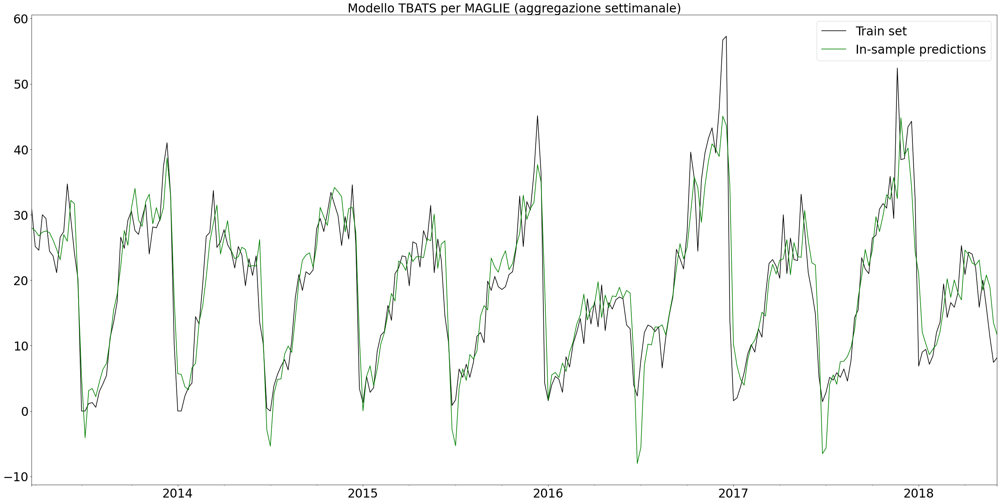

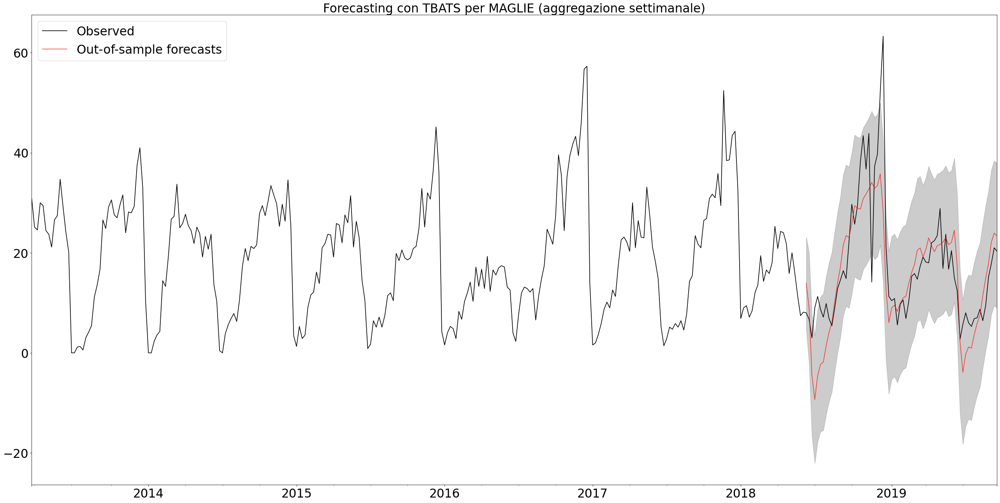

MSE=62.1246
MAE=5.4787


In [5]:
from tbats import TBATS


def tbats_model(timeseries, train_length, s, slow=True):
    """
    Previsioni con il modello TBATS

    Parameters
    ----------
    timeseries : Series
        la serie temporale.
    train_length : int
        la lunghezza del set di train (in rapporto alla serie completa).
    s : list
        l'array dei periodi stagionali.
    slow : bool
        se False velocizza il processo di scelta del modello finale (di default è True).

    Returns
    -------
    None.

    """
    # controllo se i dati sono settimanali o giornalieri
    if s.count(52) == 1:
        f = 'W-MON'
    else:
        f = 'D'
    
    # creo il set di train
    train = timeseries[pd.date_range(start=timeseries.index[0], end=timeseries.index[int(len(timeseries) * train_length)-1], freq=f)]

    # adatto il modello ai dati
    if slow:
        estimator_slow = TBATS(seasonal_periods=s)
        model = estimator_slow.fit(train)
    else:
        estimator = TBATS(
            seasonal_periods=s,
            use_arma_errors=False,  # shall try only models without ARMA
            use_box_cox=False       # will not use Box-Cox
        )
        model = estimator.fit(train)
    
    # stampo i parametri del modello
    print(model.summary())
    
    # predizioni in-sample (model.y_hat = train - model.resid)
    preds = model.y_hat
    tbats_dates = pd.date_range(start=timeseries.index[0], end=timeseries.index[len(train)-1], freq=f)
    tbats_ts = pd.Series(preds, index=tbats_dates)
    
    # predizioni out-of-sample
    fcast, conf_int = model.forecast(steps=len(timeseries)-len(train), confidence_level=0.95)
    fcast_dates = pd.date_range(start=timeseries.index[len(train)], periods=len(timeseries)-len(train), freq=f)
    ts_fcast = pd.Series(fcast, index=fcast_dates)
    ts_ci_min = pd.Series(conf_int['lower_bound'], index=fcast_dates)
    ts_ci_max = pd.Series(conf_int['upper_bound'], index=fcast_dates)
    
    # grafico del modello
    plt.figure(figsize=(40, 20), dpi=80)
    plt.title('Modello TBATS per {}'.format(timeseries.name))
    ax = train.plot(label='Train set', color='black')
    tbats_ts.plot(ax=ax, label='In-sample predictions', color='green')
    plt.legend()
    plt.show()
    
    # grafico delle previsioni
    plt.figure(figsize=(40, 20), dpi=80)
    plt.title('Forecasting con TBATS per {}'.format(timeseries.name))
    ax = timeseries.plot(label='Observed', color='black')
    ts_fcast.plot(ax=ax, label='Out-of-sample forecasts', alpha=.7, color='red')
    ax.fill_between(fcast_dates, ts_ci_min, ts_ci_max, color='k', alpha=.2)
    plt.legend()
    plt.show()
    
    # metriche di errore
    errore = ts_fcast - timeseries
    errore.dropna(inplace=True)
    print('MSE=%.4f'%(errore ** 2).mean())
    print('MAE=%.4f'%(abs(errore)).mean())


# modello TBATS con stagionalità annuale e semestrale (52 e 26 settimane)
tbats_model(new_ts, 0.8, [52, 26], slow=False)

### Confronto tra metriche di errore

Confrontiamo ora le prestazioni dei vari modelli utilizzando MSE (Mean Squared Error) e MAE (Mean Absolute Error) come metriche.

|     | SARIMAX  | TBATS    | SARIMAX (aggregazione) | TBATS (aggregazione) |
| --- | -------: | -------: | ---------------------: | -------------------: |
| MSE | 244.3164 | 157.9947 |                39.5972 |              62.1246 |
| MAE |  10.9839 |   9.2032 |                 4.2767 |               5.4787 |

Come previsto, SARIMAX fornisce un modello scadente rispetto a TBATS in quanto non è in grado di modellare la stagionalità annuale e semestrale. Sui dati aggregati, invece, SARIMAX riesce a fare meglio di TBATS. Infatti, se la durata della stagione non è troppo lunga, SARIMAX si comporta in maniera meno generica rispetto a TBATS.

# Serie storiche gerarchiche <a class='anchor' id='gerarchica-ts'/>

## Introduzione
Introduciamo le serie gerarchiche per mezzo di un esempio. Supponiamo di avere i dati di vendita mensili di ogni prodotto di un supermercato e di voler prevedere le vendite totali del negozio del mese prossimo. La serie che a noi interessa, ovvero le vendite totali del negozio, è ricavabile sommando i dati di vendita dei singoli prodotti. Le serie delle vendite dei singoli prodotti permettono di trovare non solo le vendite totali del negozio, ma anche le vendite di una specifica categoria di prodotti. Diamo dunque il nome di gerarchica a quella collezione di serie storiche che sono legate fra loro e che formano una struttura gerarchica ad albero.

Consideriamo ora la serie gerarchica composta da 3 livelli mostrata nella figura sottostante.

<center><img src="img/gerarchia.png" alt="Drawing" style="width: 30%;"/>
<br/><b>Serie gerarchica composta da 3 livelli</b></center>

Con $n$ indichiamo il numero totale di serie all'interno della struttura (8 in questo caso 1+2+5) mentre con $m$ indichiamo il numero di serie che stanno al livello più basso della gerarchia, dove $n > m$.

Scriviamo formalmente le relazioni, definite intuitivamente nell'esempio del supermercato, che legano le serie di livello inferiore con quelle di livello superiore.

- $y_t=y_{AA,t} + y_{AB,t} + y_{AC,t} + y_{BA,t} + y_{BB,t}$

- $y_{A,t}=y_{AA,t} + y_{AB,t} + y_{AC,t}$

- $y_{B,t}=y_{BA,t} + y_{BB,t}$

- $y_t=y_{A,t} + y_{B,t}$

Piccola nota. La sintassi prevede l'uso di due pedici, il primo per denotare il nodo e il secondo per l'osservazione quindi $y_{AB,\overline{t}}$ individua la $\overline{t}$-esima osservazione della serie corrispondente al nodo AB.

Le equazioni possono essere riscritte come:

\begin{gather}
    \begin{bmatrix}
    y_t \\
    y_{A,t} \\
    y_{B,t} \\
    y_{AA,t} \\
    y_{AB,t} \\
    y_{AC,t} \\
    y_{BA,t} \\
    y_{BB,t}
    \end{bmatrix}
    =
    \begin{bmatrix}
    1 & 1 & 1 & 1 & 1 \\
    1 & 1 & 1 & 0 & 0 \\
    0 & 0 & 0 & 1 & 1 \\
    1 & 0 & 0 & 0 & 0 \\
    0 & 1 & 0 & 0 & 0 \\
    0 & 0 & 1 & 0 & 0 \\
    0 & 0 & 0 & 1 & 0 \\
    0 & 0 & 0 & 0 & 1
    \end{bmatrix}
    \begin{bmatrix}
    y_{AA,t} \\
    y_{AB,t} \\
    y_{AC,t} \\
    y_{BA,t} \\
    y_{BB,t}
    \end{bmatrix}
\end{gather}

<br/>
<center>$\hat{y_t} = S b_t$ </center>

dove $\hat{y_t}$ è un vettore n-dimensionale che rappresenta tutte le serie temporali all'istante t, $b_t$ è m-dimensionale e contiene le serie alla base della gerarchia e infine abbiamo la matrice delle somme indicata con $S$ di dimensione $nxm$. Da notare il fatto che le prime tre righe della matrice $S$ corrispondono alle prime tre equazioni, mentre il resto della matrice è uguale alla matrice di identità $I_m$.

## Previsioni

Le previsioni su una serie gerarchica possono essere fatte creando dei modelli per ogni singola serie, tuttavia questo tipo di approccio risulta estremamente lento soprattutto se la struttura presenta un numero elevato di nodi. Inoltre questo modus operandi non tiene in considerazione le relazioni che esistono fra i vari nodi dell'albero e potrebbero dunque sussistere delle incoerenze fra le varie previsioni. Definiamo dunque 3 approcci per le previsioni:
- Bottom-up
- Top-down
- Middle-out

### Bottom-up

Questo metodo è il più semplice fra i tre in quanto prevede di creare le previsioni delle serie che stanno alla base della gerarchia, per poi sommarle insieme, seguendo la matrice delle somme, producendo le previsioni di tutte le serie appartenenti alla struttura. Di fatto rappresenta la diretta applicazione della scrittura $\hat{y_t} = S b_t$ con la differenza che in questo caso avremo $t=\overline{t}+h$, dove $\overline{t}$ rappresenta l'istante associato all'ultima osservazione delle serie temporali e h è l'orizzonte di previsione ($h > 0$).

I vantaggi di bottom-up sono:
- non perdiamo informazioni durante la transizione da livelli inferiori a superiori
- definiamo meglio le previsioni delle singole serie temporali

Gli svantaggi invece sono:
- creazione di un gran numero di previsioni dato che il numero delle serie di livello inferiore è molto elevato
- la costruzione dei modelli di previsioni delle serie di livello superiore risente degli errori dei modelli di livello inferiore

### Top-down

È l'opposto del metodo Bottom-up. Qui dobbiamo generare le previsioni della serie totale per poi disaggregarle in previsioni per le serie sottostanti. Dichiariamo $p=[p_1,...,p_m]'$ il vettore di coefficienti di proporzionalità tali che

\begin{equation*}
y_{AA,t}=p_1 y_t \\
y_{AB,t}=p_2 y_t \\
y_{AC,t}=p_3 y_t \\
y_{BA,t}=p_4 y_t \\
y_{BB,t}=p_5 y_t
\end{equation*}

con $t=\overline{t}+h$. L'equazione matriciale che descrive le relazioni appena introdotte, $b_t = p y_t$, consente di riscrivere la $\hat{y_t} = S b_t$ come $\hat{y_t} = S p y_t$.

Ora ciò che manca è stabilire come ricavare i coefficienti di proporzionalità. I due metodi più comuni sono:

- media dei rapporti storici
- rapporto delle medie storiche

La media dei rapporti storici calcola il singolo coefficiente $p_j$ come media del rapporto fra l'osservazione della serie $y_j$ e di $y_t$ ovvero

\begin{equation*}
p_j=\frac{1}{T} \sum_{t=1}^T \frac{y_{j,t}}{y_t}
\end{equation*}

dove $T$ indica il numero delle osservazioni della serie. Mentre nel rapporto delle medie storiche prima si calcolano le medie delle singole serie temporali e poi si mettono in rapporto

\begin{equation*}
p_j=\sum_{t=1}^T \frac{y_{j,t}}{T}\Big/\sum_{t=1}^T \frac{y_t}{T}
\end{equation*}

I vantaggi di top-down sono:
- realizziamo una sola previsione
- crea buone previsioni per i livelli sottostanti

Gli svantaggi sono:
- perdita di informazione a causa dei coefficienti di proporzionalità che approssimano le serie temporali alla base della gerarchia
- trovare i coefficienti di proporzionalità migliori

### Middle-out

Questo criterio combina i due approcci visti precedentemente. Prima si calcolano le previsioni delle serie di livello intermedio e poi si usa bottom-up per generare previsioni coerenti delle serie superiori e top-down per quelle inferiori.

## Esempio con i dati della competizione M5

Come da prassi diviamo il codice in tre celle dove nella prima troviamo gli import con anche la definizione di aspetti grafici legati ai plot. Nella seconda cella troviamo le funzioni e nella terza il main.

In [2]:
import datetime
import matplotlib.pylab as plt
import matplotlib.pyplot as pplt
import numpy as np
import pandas as pd
import statsmodels.api as sm
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from statsmodels.tsa.seasonal import seasonal_decompose
from sklearn.metrics import mean_squared_error

# SOPPRIMIAMO I WARNING DI NUMPY
np.warnings.filterwarnings('ignore')

# IMPOSTAZIONI SUI GRAFICI
SMALL_SIZE = 32
MEDIUM_SIZE = 34
BIGGER_SIZE = 40
COLOR_ORIG = 'black'
COLOR_MODEL = 'green'
COLOR_FOREC = 'red'
COLOR_ACF = 'blue'
COLORPALETTE = ['red', 'gold', 'blue', 'green', 'purple', 'orange', 'black', 'lime', 'cyan', 'peru', 'gray']
 
plt.rc('font', size=MEDIUM_SIZE)         # controls default text sizes 
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title 
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels 
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels 
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels 
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize 
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

Defiamo le funzioni che utilizzeremo.
- plot va a graficare le serie temporali passate come parametro
- plot_results va a graficare la serie temporale con modello e previsioni assegnando a ciascuna di esse un colore specifico
- load_data carica il csv in un dataframe
- sumrows calcola le vendite giornaliere di un dataframe. Ciascuna riga del dataframe indica le vendite di UN SINGOLO prodotto
- rolling esegue la media mobile passando come parametro la serie temporale e la finestra
- autocorrelation crea i grafici delle funzioni di auto-correlazione delle serie temporali passate come parametro
- pautocorrelation crea i grafici delle funzioni di auto-correlazione parziale delle serie temporali passate come parametro
- ETS_DECOMPOSITION_FORECASTING calcola le previsioni della serie temporale ritornando il modello predittivo con le previsioni del modello. Per gestire la componente RESIDUI, come nell'esercizio precedente, si userà ARIMA
- save_obj permette di salvare un oggetto su un file. Noi la usiamo dopo aver generato le previsioni delle serie temporali di negozio&cat per poi caricarle al prossimo lancio del programma
- load_obj permette di caricare un oggetto da un file

In [3]:
def plot(timeseries = [], labels = [], titolo=''):
    """
    Parameters
    ----------
    timeseries : TYPE, optional
        DESCRIPTION. The default is [].
    labels : TYPE, optional
        DESCRIPTION. The default is [].
    titolo : TYPE, optional
        DESCRIPTION. The default is ''.
    Returns
    -------
    None.
    """
    plt.figure(figsize=(80, 40), dpi=60)
    plt.title(titolo)
    plt.ylabel('Vendite')
    plt.xlabel('Data')
    i=0
    for serie in timeseries:
        plt.plot(serie, label = str(labels[i]), color = COLORPALETTE[i])
        i += 1
    plt.legend(loc='best')
    plt.show(block=False)
    return 

def plot_results(timeseries = [], labels = [], titolo=''):
    """
    TSC (training set color) : 
        'black'  
    VSC (validation set color) : 
        'black'  
    FC (forecast color) : 
        'red'    
    MRC (model results color) : 
        'green'  
    OLC (other lines color) : 
        'orange'

    Parameters
    ----------
    timeseries : timeseries[], optional
        DESCRIPTION. The default is []. Order: TSC, VSC, FC, MRC, OLC
    labels : str[], optional
        DESCRIPTION. The default is []. Order: TSC, VSC, FC, MRC, OLC
    titolo : TYPE, optional
        DESCRIPTION. The default is ''.
    Returns
    -------
    None.
    """
    RESCOLORPALETTE = ['black','black','red','green','orange']
    plt.figure(figsize=(40, 20), dpi=80)
    plt.title(str(titolo))
    plt.ylabel('Vendite')
    plt.xlabel('Data')
    i=0
    for serie in timeseries:
        if i==1: # validation set
            plt.plot(serie, label = str(labels[i]), color = RESCOLORPALETTE[i], linestyle = '--')
        else:
            plt.plot(serie, label = str(labels[i]), color = RESCOLORPALETTE[i])
        i += 1
    plt.legend(loc='best')
    plt.show(block=False)
    return 

def load_data(filename, indexData=False):
    if indexData:        
        dateparser = lambda dates: datetime.datetime.strptime(dates, '%Y-%m-%d')
        dataframe = pd.read_csv(filename, index_col = 0, date_parser=dateparser)
    else:
        dataframe = pd.read_csv(filename)
    return dataframe

def sumrows(dataframe, giorni):
    res = [0]
    for g in giorni:
        ind = len(res) - 1
        for value in dataframe[g]:
            res[ind] += value
        res.append(0)

    # Rimuoviamo l'ultimo elemento che è 0
    return res[:-1]

def rolling(ts, w, meanOrStd=True):
    '''
    Parameters
    ----------
    ts : pd.Series
        Serie temporale
    w : integer
        Finestra della rolling
    meanOrStd : bool, optional
        True se rolling mean, False std. The default is True.
    Returns
    -------
    Rolling mean

    '''
    if meanOrStd:
        return ts.rolling(window=w).mean()
    return ts.rolling(window=w).std()

def autocorrelation(ts = [], lags = 20, titleSpec = ''):
    """
    Parameters
    ----------
    ts : pd.Series
        Lista di serie temporali
    lags : integer
        Ampiezza finestra di visualizzazione del grafico di autocorrelazione
    titleSpec : str
        Specifica le serie di cui si calcola l'autocorrelazione (di fatto una 
        parte del titolo del grafico...)
    Returns
    -------
    None.
    """
    autocor = []
    for timeserie in ts:
        autocor.append(acf(timeserie, nlags=lags))
    i = 0
    plt.figure(figsize=(80, 40), dpi=60)
    for fun in autocor:
        plt.plot(fun, color = COLORPALETTE[i])
        i += 1
    #Delimito i tre intervalli
    plt.axhline(y=0,linestyle='--',color='gray')
    plt.axhline(y=-1.96/np.sqrt(len(ts)),linestyle='--',color='black')
    plt.axhline(y=1.96/np.sqrt(len(ts)),linestyle='--',color='black')
    plt.legend(loc = 'best')
    title = 'Funzione di autocorrelazione: ' + str(titleSpec) 
    plt.title(title)
    
def pautocorrelation(ts = [], lags = 20, titleSpec = '', logbool = False):
    """
    Parameters
    ----------
    ts : pd.Series
        Lista di serie temporali
    lags : integer
        Ampiezza finestra di visualizzazione del grafico di autocorrelazione
    titleSpec : str
        Specifica le serie di cui si calcola l'autocorrelazione (di fatto una 
        parte del titolo del grafico...)
    Returns
    -------
    None.
    """
    pautocor = []
    for timeserie in ts:
        pautocor.append(pacf(timeserie, nlags=lags, method = 'ols'))
    i = 0
    plt.figure(figsize=(80, 40), dpi=60)
    if logbool:
        pplt.yscale('log')
    for fun in pautocor:
        plt.plot(fun, color = COLORPALETTE[i])
        i += 1
    #Delimito i tre intervalli
    plt.axhline(y=0,linestyle='--',color='gray')
    plt.axhline(y=-1.96/np.sqrt(len(ts)),linestyle='--',color='black')
    plt.axhline(y=1.96/np.sqrt(len(ts)),linestyle='--',color='black')
    plt.legend(loc = 'best')
    title = 'Funzione di autocorrelazione parziale: ' + str(titleSpec) 
    plt.title(title)

def ETS_DECOMPOSITION_FORECASTING(ts, periodo=365, due_lati=False, h=100):
    '''
    La funzione ETS_FORECASTING calcola, per decomposizione, le previsioni serie temporali
    ritornando il modello e le previsioni
    Parameters
    ----------
    ts : pd.Series
        Serie temporale
    periodo : int, optional
        Il periodo di stagionalità. The default is 365.
    due_lati : bool, optional
        Indica il two_sided della decomposizione. The default is False.
    
    h : int, optional
        Orizzonte di previsione
    Returns: 
    -------
    (model, model_forecasting) ovvero il modello e le previsioni
    '''
    decomposition = seasonal_decompose(ts, period=periodo, two_sided=due_lati)
    
    trend = decomposition.trend
    seasonal = decomposition.seasonal
    residual = decomposition.resid
    
    trend.dropna(inplace=True)
    seasonal.dropna(inplace=True)
    residual.dropna(inplace=True)    

    # Creiamo dei modelli per trend e seasonal + USO ARIMA PER I RESIDUAL VISTO CHE SONO UNA COMPONENTE STAZION.
    trend_model = ExponentialSmoothing(trend, trend="add", damped = True, seasonal=None)
    seasonal_model = ExponentialSmoothing(seasonal, trend=None, seasonal='add', seasonal_periods=periodo)

    # facciamo il fit dei modelli
    trend_fitted    = trend_model.fit()
    seasonal_fitted = seasonal_model.fit()
    
    # ARIMA per i residui. (5,0,5) quando possibile altrimenti la componente q diminuisce. Rappresenta il giusto compromesso
    flag = True
    q = 5
    residual_fitted = None
    while flag:
        try:
            residual_model = ARIMA(residual, order=(5, 0, q))
            #fit model
            residual_fitted = residual_model.fit()
            flag = False
        except:
            q -= 1
            
    
    # creiamo le previsioni
    trend_model_predictions = trend_fitted.forecast(steps=h)
    seasonal_model_predictions = seasonal_fitted.forecast(steps=h)
    residual_model_predictions, _, _ = residual_fitted.forecast(steps=h)
    
    # Sommo i modelli
    model = trend_fitted.fittedvalues \
                + seasonal_fitted.fittedvalues \
                + residual_fitted.fittedvalues

    # Sommo le previsioni
    model_forecasting = trend_model_predictions \
                        + seasonal_model_predictions \
                        + residual_model_predictions                       
    model_forecasting.dropna(inplace=True)
    
    return (model, model_forecasting)

def save_obj(obj, filename):
    '''
    save_list salva un oggetto su un file in filename 
    Parameters
    ----------
    l : list
        lista da salvare
    filename : str
        path del file

    Returns
    -------
    None.
    '''
    import pickle

    with open(filename, 'wb') as fout:
        pickle.dump(obj, fout, pickle.HIGHEST_PROTOCOL)

def load_obj(filename):
    '''
    load_list recupera un oggetto da un file
    Parameters
    ----------
    filename : str
        path del file da caricare

    Returns
    -------
    None.

    '''
    import pickle
    res = None
    with open(filename, 'rb') as fin:
        res = pickle.load(fin)

        return res

Il main è stato diviso in due celle. Nella prima defiamo e studiamo le serie temporali mentre nella seconda eseguiamo le previsioni sulla serie gerarchica.

- carichiamo il file "sales_train_validation.csv" e realizziamo le diverse serie temporali raggruppate per livello
- definiamo la lista "giorni" che contiene le stringhe d1, d2, ... , d1913 che rappresentano gli istanti di campionamento dei dati
- calcoliamo per ciascun livello della serie gerarchica la rolling mean (mostra l'andamento tendenziale delle serie) e le funzioni di auto-correlazione e auto-correlazione parziale

Caricamento sales_train_validation.csv ... Carimento completato
Creazione serie temporali (ancora dataframe) ... Creazione completata
Sto creando le serie temporali delle vendite per negozio... Operazione completata
Genero le rolling mean per negozio...  Operazione completata
Plot del grafico... 

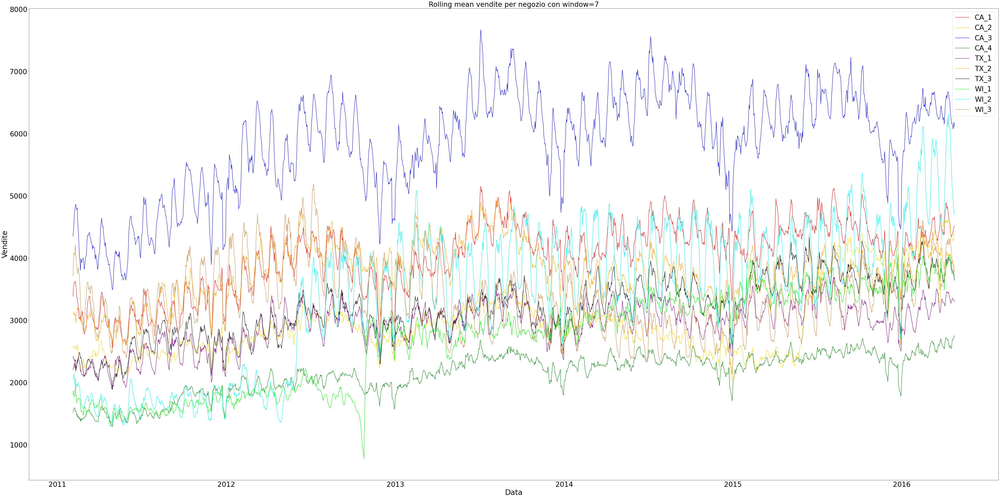

No handles with labels found to put in legend.
No handles with labels found to put in legend.


Operazione completata


No handles with labels found to put in legend.
No handles with labels found to put in legend.


Sto creando le serie temporali delle vendite per stato... Operazione completata
Genero le rolling mean per stato...  Operazione completata
Plot del grafico... 

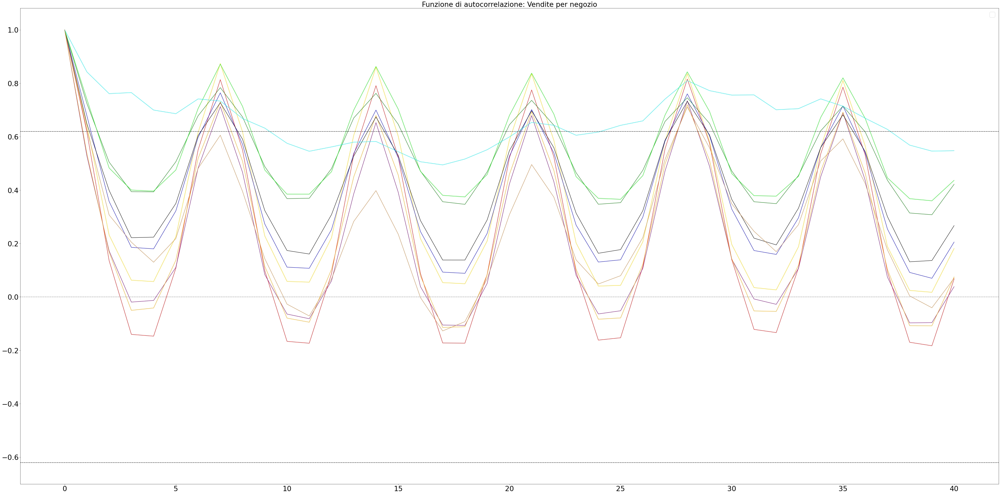

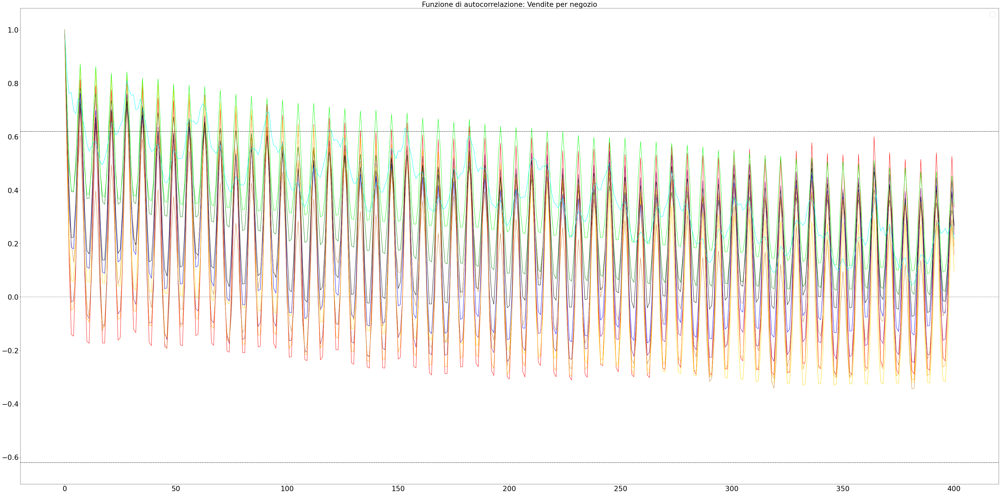

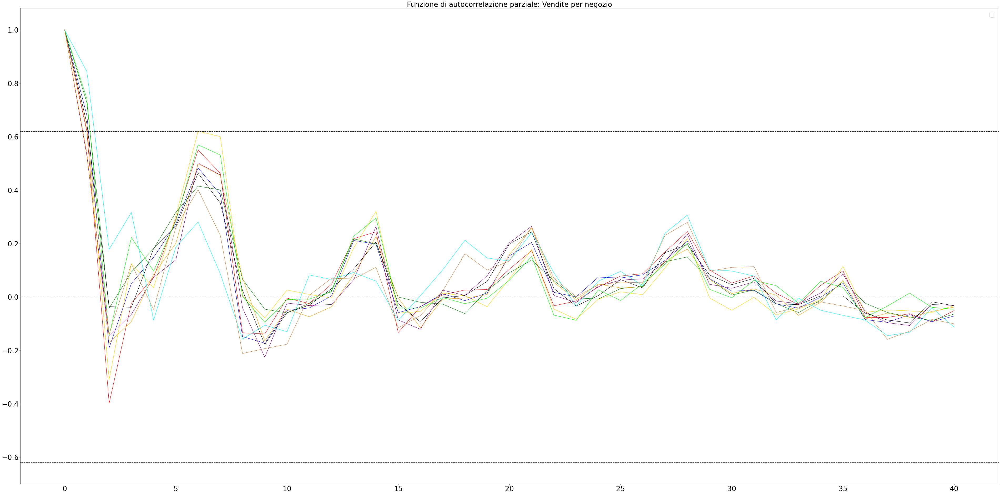

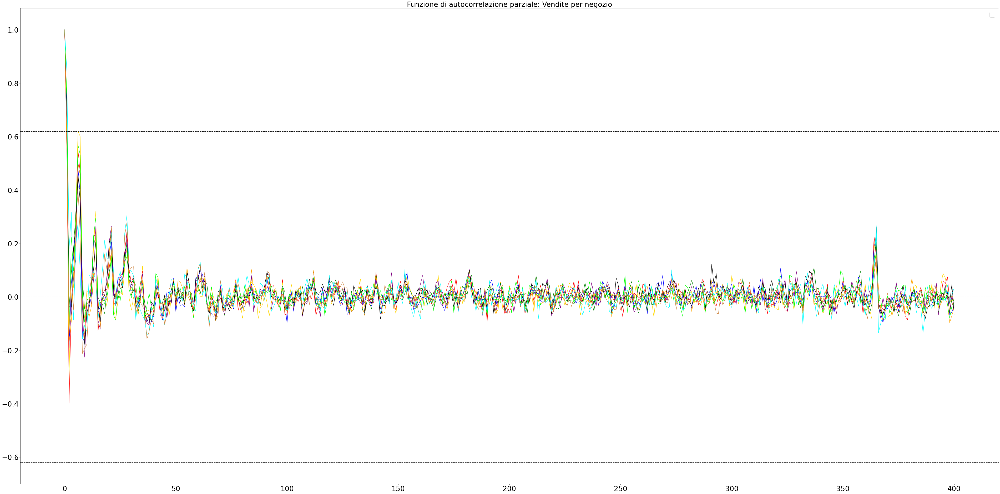

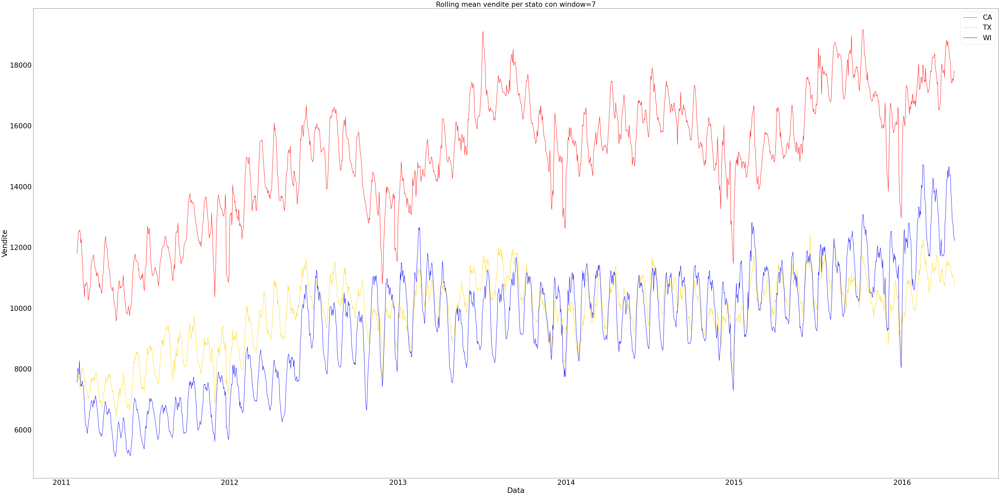

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


Operazione completata


No handles with labels found to put in legend.


Sto creando le serie temporali delle vendite per categoria... Operazione completata
Genero le rolling mean per categoria...  Operazione completata
Plot del grafico... 

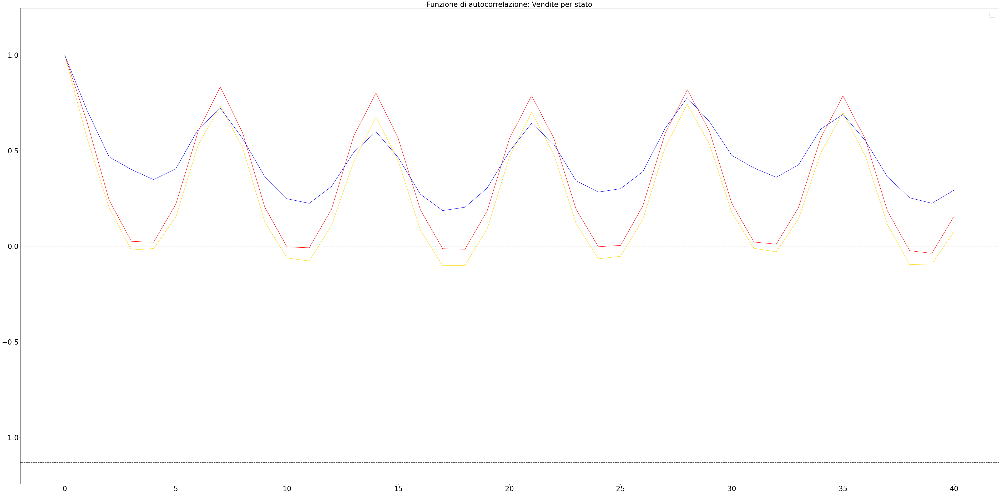

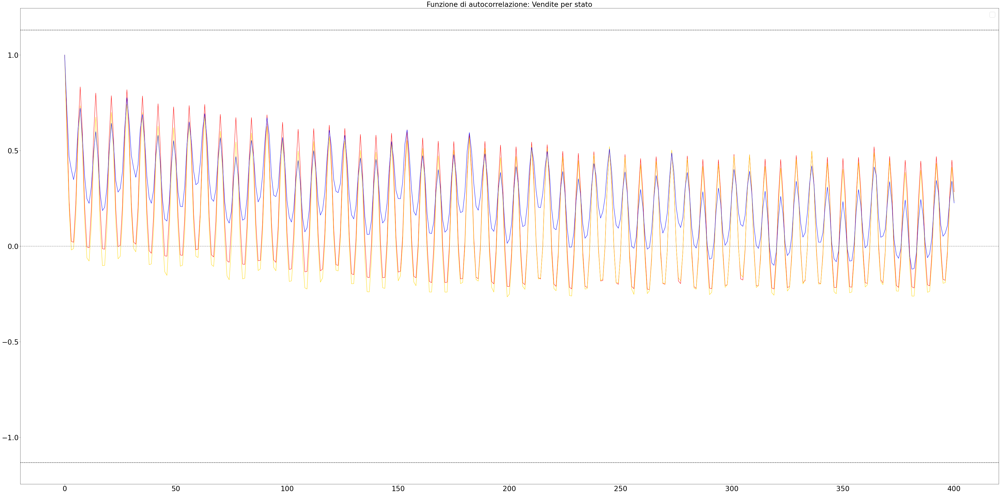

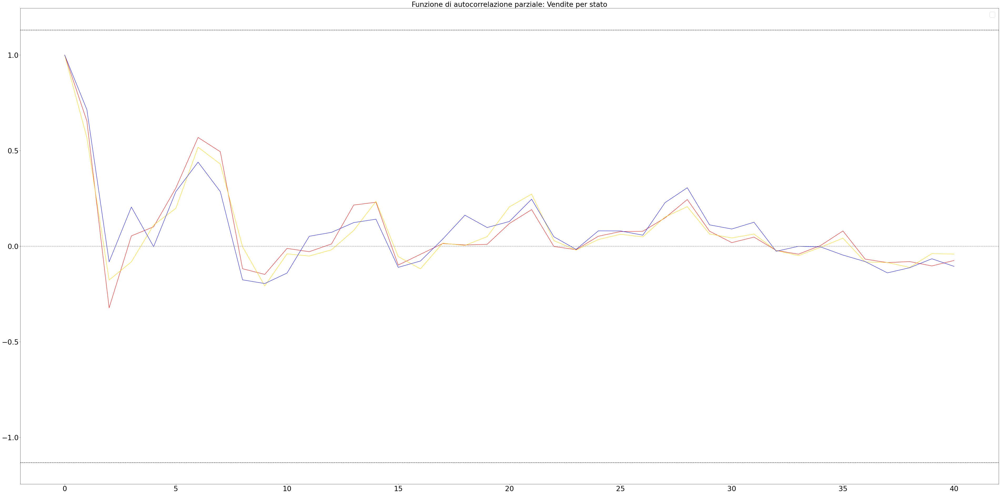

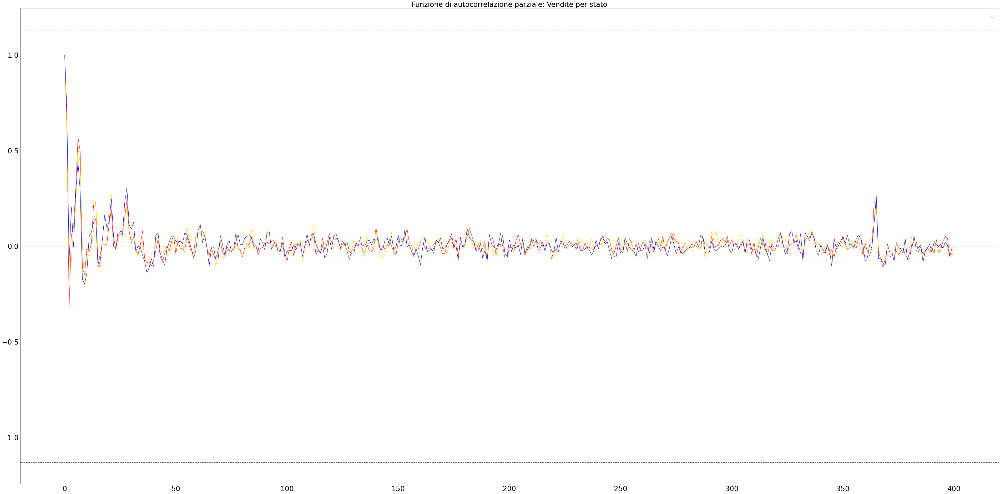

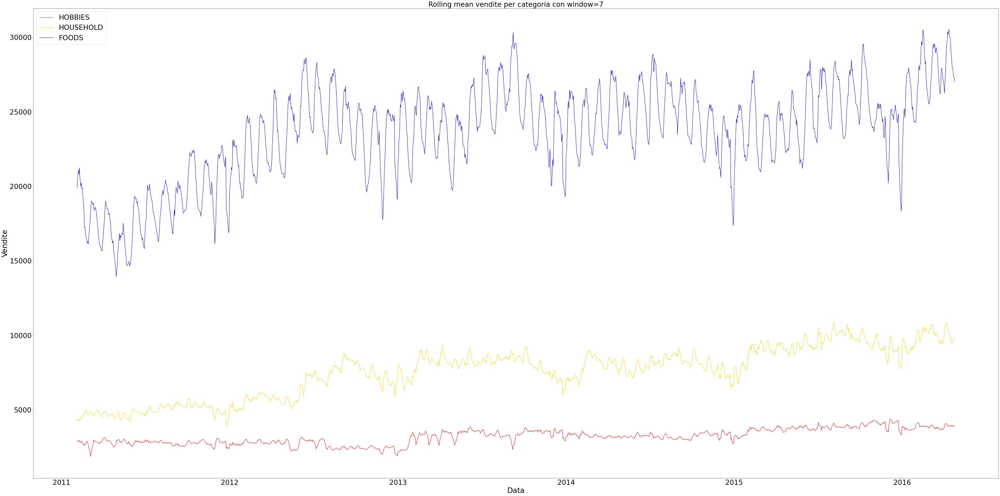

No handles with labels found to put in legend.
No handles with labels found to put in legend.


Operazione completata


No handles with labels found to put in legend.
No handles with labels found to put in legend.


Sto creando le serie temporali delle vendite per stato e categoria... Operazione completata
Genero le rolling mean per stato e categoria...  Operazione completata
Plot del grafico... 

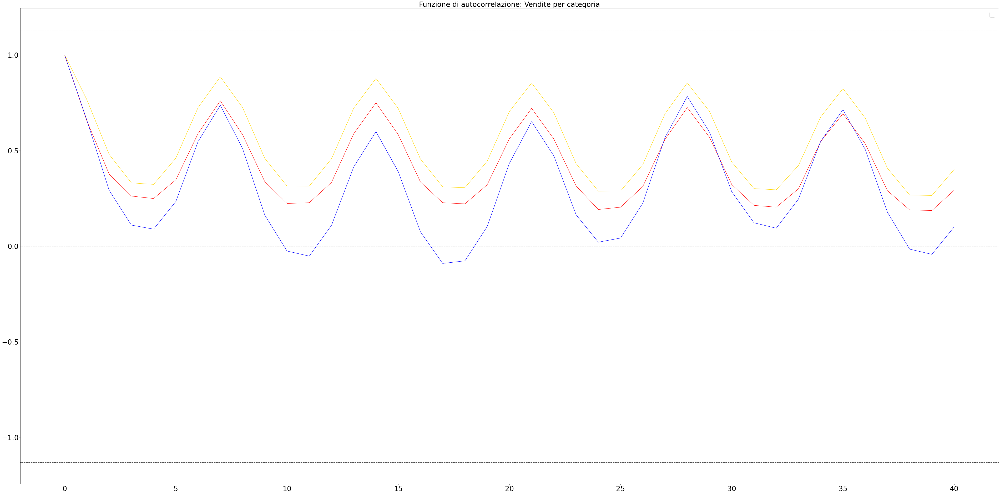

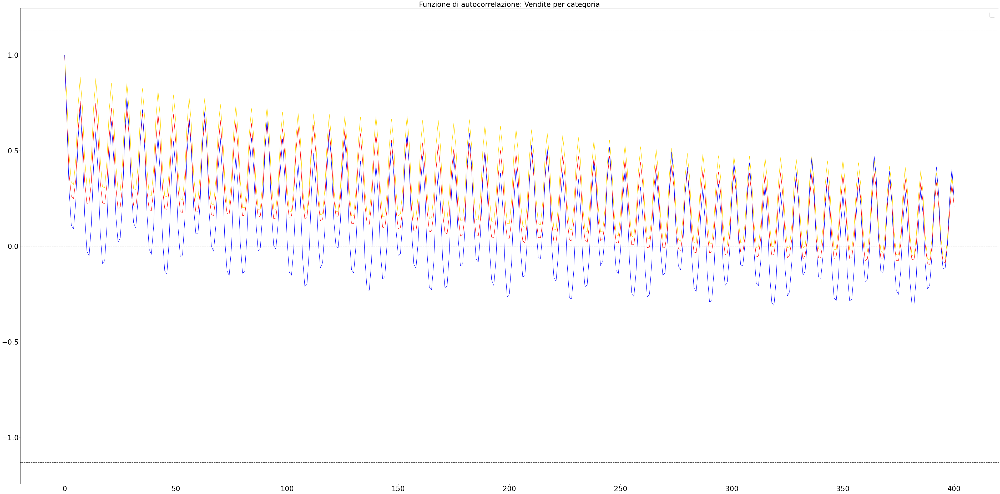

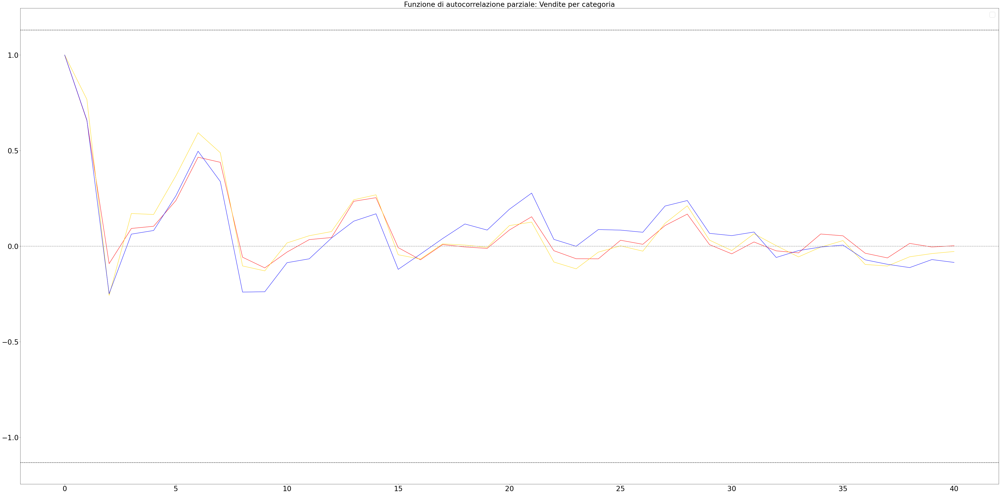

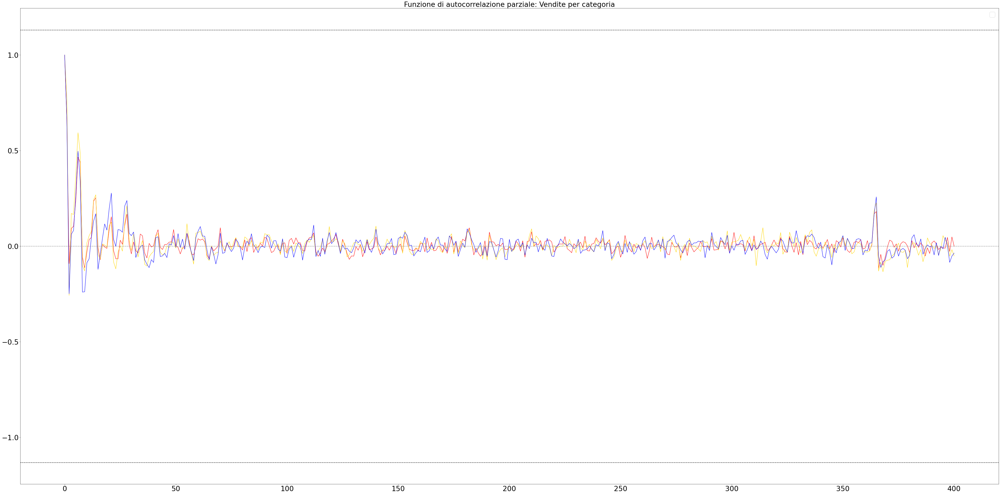

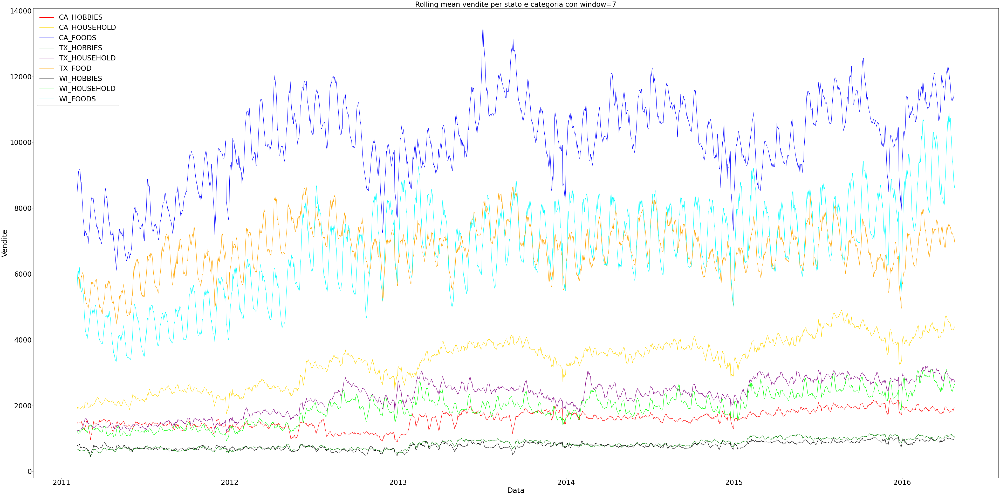

No handles with labels found to put in legend.
No handles with labels found to put in legend.


Operazione completata


No handles with labels found to put in legend.
No handles with labels found to put in legend.


Sto creando le serie temporali delle vendite per negozio e categoria... Operazione completata
Genero le rolling mean per negozio e categoria...  Operazione completata


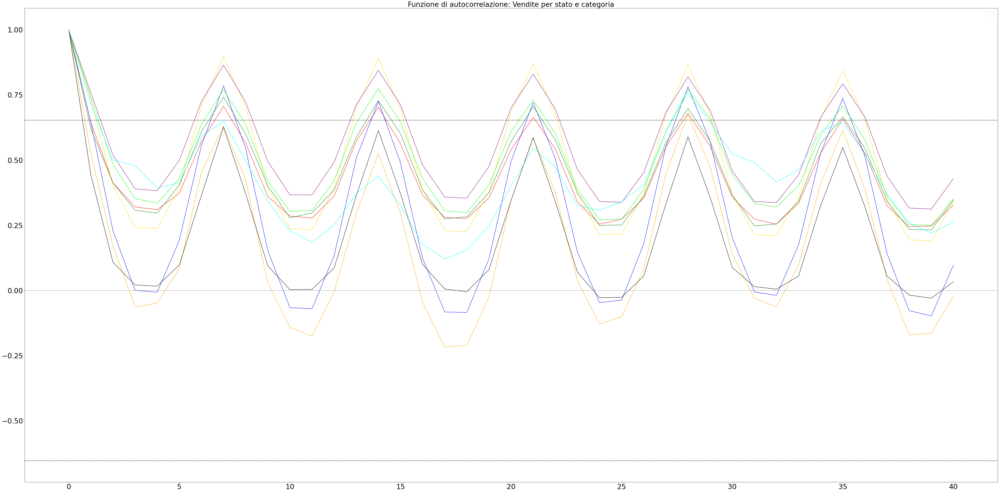

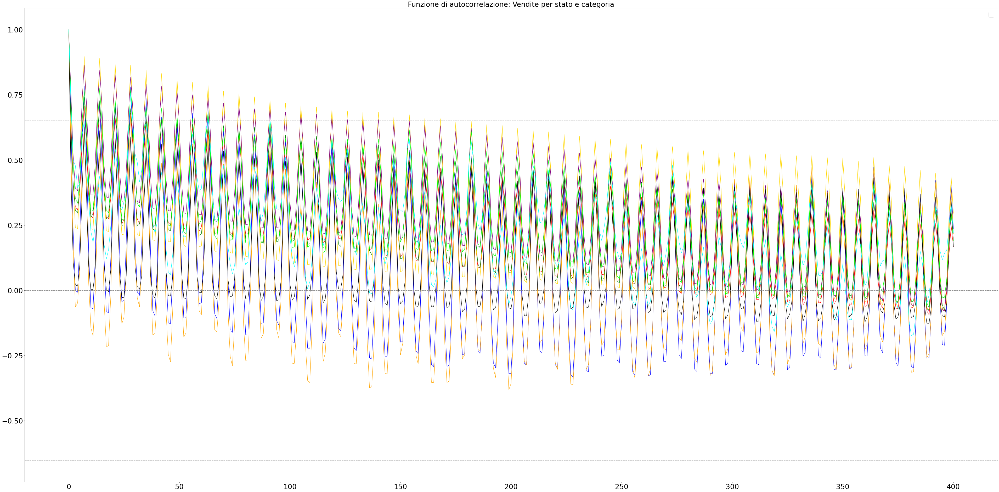

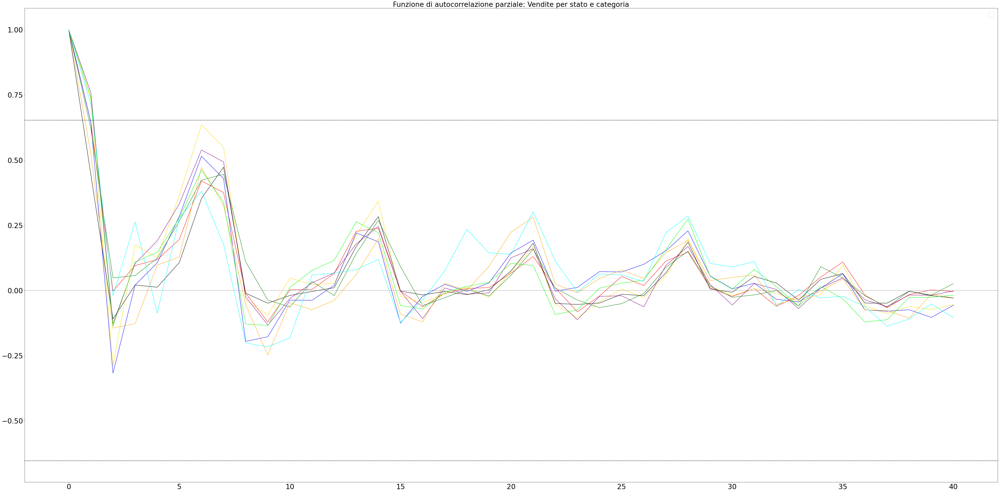

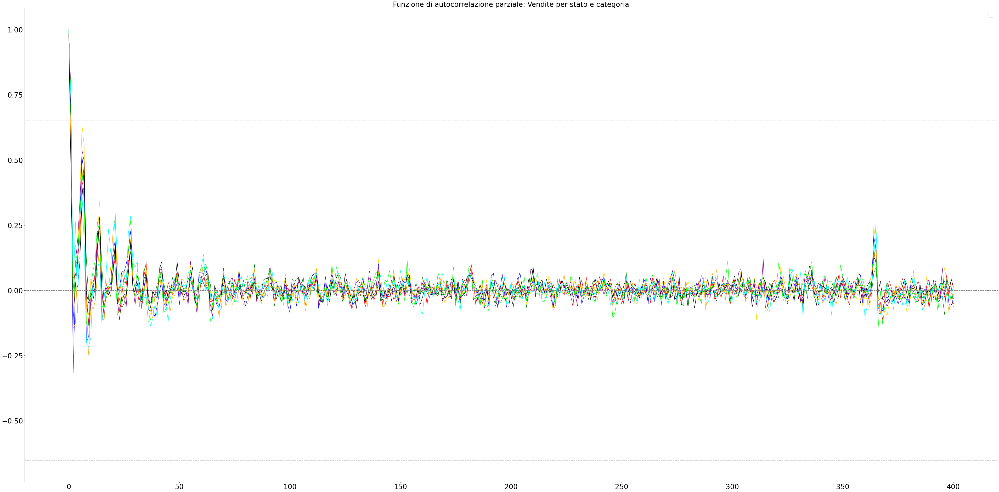

In [5]:
if __name__ == '__main__':
    # andiamo a caricare i dati del set di validazione (già pronto nel file sales_train_validation.csv)
    
    print('Caricamento sales_train_validation.csv ...', end=' ')
    sales_train = load_data('./datasets/sales_train_validation.csv')
    print('Carimento completato')
    
    # definiamo i nomi delle proprietà/campi che troviamo nel file sales_train_validation.csv
    shopNames = ['CA_1', 'CA_2', 'CA_3', 'CA_4', 'TX_1', 'TX_2', 'TX_3', 'WI_1', 'WI_2', 'WI_3']
    stateNames = ['CA', 'TX', 'WI']
    catNames = ['HOBBIES', 'HOUSEHOLD', 'FOODS']
    StatoAndCatNames = ['CA_HOBBIES', 'CA_HOUSEHOLD', 'CA_FOODS', 'TX_HOBBIES', 'TX_HOUSEHOLD', 'TX_FOOD',
                        'WI_HOBBIES', 'WI_HOUSEHOLD', 'WI_FOODS']
    

    # creiamo i DATAFRAME che rappresenteranno le serie temporali nelle sezioni successive
    print('Creazione serie temporali (ancora dataframe) ...', end=' ')
    
    # DATAFRAME per categoria
    hobby = sales_train[sales_train['cat_id'] == 'HOBBIES']
    household = sales_train[sales_train['cat_id'] == 'HOUSEHOLD']
    food = sales_train[sales_train['cat_id'] == 'FOODS']

    # DATAFRAME per negozio
    shopCA1 = sales_train[sales_train['store_id'] == 'CA_1']
    shopCA2 = sales_train[sales_train['store_id'] == 'CA_2']
    shopCA3 = sales_train[sales_train['store_id'] == 'CA_3']
    shopCA4 = sales_train[sales_train['store_id'] == 'CA_4']
    
    shopTX1 = sales_train[sales_train['store_id'] == 'TX_1']
    shopTX2 = sales_train[sales_train['store_id'] == 'TX_2']
    shopTX3 = sales_train[sales_train['store_id'] == 'TX_3']
    
    shopWI1 = sales_train[sales_train['store_id'] == 'WI_1']
    shopWI2 = sales_train[sales_train['store_id'] == 'WI_2']
    shopWI3 = sales_train[sales_train['store_id'] == 'WI_3']
    
    # DATAFRAME per stato
    stateCA = sales_train[sales_train['state_id'] == 'CA']
    stateTX = sales_train[sales_train['state_id'] == 'TX']
    stateWI = sales_train[sales_train['state_id'] == 'WI']

    # DATAFRAME per stato e categoria
    stateCAhobbies = sales_train[np.logical_and(sales_train['state_id'] == 'CA', sales_train['cat_id'] == 'HOBBIES')]
    stateCAhousehold = sales_train[np.logical_and(sales_train['state_id'] == 'CA', sales_train['cat_id'] == 'HOUSEHOLD')]
    stateCAfoods = sales_train[np.logical_and(sales_train['state_id'] == 'CA', sales_train['cat_id'] == 'FOODS')]
    
    stateTXhobbies = sales_train[np.logical_and(sales_train['state_id'] == 'TX', sales_train['cat_id'] == 'HOBBIES')]
    stateTXhousehold = sales_train[np.logical_and(sales_train['state_id'] == 'TX', sales_train['cat_id'] == 'HOUSEHOLD')]
    stateTXfoods = sales_train[np.logical_and(sales_train['state_id'] == 'TX', sales_train['cat_id'] == 'FOODS')]
    
    stateWIhobbies = sales_train[np.logical_and(sales_train['state_id'] == 'WI', sales_train['cat_id'] == 'HOBBIES')]
    stateWIhousehold = sales_train[np.logical_and(sales_train['state_id'] == 'WI', sales_train['cat_id'] == 'HOUSEHOLD')]
    stateWIfoods = sales_train[np.logical_and(sales_train['state_id'] == 'WI', sales_train['cat_id'] == 'FOODS')]    
    
    #DATAFRAME per negozio e categoria
    shopAndCatList = []
    for s in shopNames:
        storeShobbies = sales_train[np.logical_and(sales_train['store_id'] == s, sales_train['cat_id'] == 'HOBBIES')]
        storeShousehold = sales_train[np.logical_and(sales_train['store_id'] == s, sales_train['cat_id'] == 'HOUSEHOLD')]
        storeSfoods = sales_train[np.logical_and(sales_train['store_id'] == s, sales_train['cat_id'] == 'FOODS')]
        shopAndCatList.append(storeShobbies)
        shopAndCatList.append(storeShousehold)
        shopAndCatList.append(storeSfoods)
        
        
        
    # raggruppiamo i dataframe in base alle proprietà
    shopList = [shopCA1, shopCA2, shopCA3, shopCA4, shopTX1, shopTX2, shopTX3, shopWI1, shopWI2, shopWI3]
    stateList = [stateCA, stateTX, stateWI]
    catList = [hobby, household, food]
    stateAndCatList = [stateCAhobbies, stateCAhousehold, stateCAfoods, stateTXhobbies, stateTXhousehold,
                       stateTXfoods, stateWIhobbies, stateWIhousehold, stateWIfoods]
    
    print('Creazione completata')
    
    
    
    # definiamo l'array delle colonne d_1, ...., d_1913. Rappresentano i giorni dal 1 al 1913-esimo
    
    giorni = []
    for column in stateCA: # PRENDIAMO UN DATAFRAME FRA QUELLI SOPRA. TUTTI CONDIVIDONO LE COLONNE d_1,..., d_1913
        if 'd_' in column:
            giorni.append(column)
    
    
    # Serie temporali per negozio
    
    # Trasformiamo i dataframe dei negozi in serie temporali. Verranno mantenute dentro tsVenditeNegozio
    tsVenditeNegozio = []
    
    print('Sto creando le serie temporali delle vendite per negozio...', end=' ')
    for shop in shopList:
        tsVenditeNegozio.append(pd.Series(data=sumrows(shop, giorni), 
                                          index=pd.date_range(start=pd.Timestamp('2011-01-29'), periods=1913, freq='D')))
    print('Operazione completata')
    
    
    # Analiziamo le serie temporali dei negozi
    
    # Plottiamo la rolling mean (visualizziamo la componente TREND)
    rollingVenditeNegozio = []
    
    print('Genero le rolling mean per negozio... ', end=' ')
    for i in range(len(tsVenditeNegozio)):
        rollingVenditeNegozio.append(rolling(tsVenditeNegozio[i], w=7))
    print('Operazione completata')
    
    
    print('Plot del grafico...', end=' ')
    plot(rollingVenditeNegozio, shopNames, 'Rolling mean vendite per negozio con window=%d'%7)
    print('Operazione completata') 
    
    # Calcolo l'autocorrelazioni delle serie di vendite per negozio
    autocorrelation(tsVenditeNegozio, titleSpec = "Vendite per negozio", lags = 40)
    autocorrelation(tsVenditeNegozio, titleSpec = "Vendite per negozio", lags = 400)
    pautocorrelation(tsVenditeNegozio, titleSpec = "Vendite per negozio", lags = 40)
    pautocorrelation(tsVenditeNegozio, titleSpec = "Vendite per negozio", lags = 400)

    
    # Serie temporali per stato
    
    tsVenditeStato = []
    
    print('Sto creando le serie temporali delle vendite per stato...', end=' ')
    for state in stateList:
        tsVenditeStato.append(pd.Series(data=sumrows(state, giorni), 
                                          index=pd.date_range(start=pd.Timestamp('2011-01-29'), periods=1913, freq='D')))
    print('Operazione completata')
    
    
    # Analiziamo le serie temporali per stato
    
    # Plottiamo la rolling mean (visualizziamo la componente TREND)
    
    rollingVenditeStato = []
    
    print('Genero le rolling mean per stato... ', end=' ')
    for i in range(len(tsVenditeStato)):
        rollingVenditeStato.append(rolling(tsVenditeStato[i], w=7))
    print('Operazione completata')
    
    
    print('Plot del grafico...', end=' ')
    plot(rollingVenditeStato, stateNames, 'Rolling mean vendite per stato con window=%d'%7)
    print('Operazione completata')
    
    # Calcolo l'autocorrelazioni delle serie di vendite per stato
    autocorrelation(tsVenditeStato, titleSpec = "Vendite per stato", lags = 40)
    autocorrelation(tsVenditeStato, titleSpec = "Vendite per stato", lags = 400)
    pautocorrelation(tsVenditeStato, titleSpec = "Vendite per stato", lags = 40)
    pautocorrelation(tsVenditeStato, titleSpec = "Vendite per stato", lags = 400)
    
    
    # Serie temporali per categoria
    
    tsVenditeCat = []
    
    print('Sto creando le serie temporali delle vendite per categoria...', end=' ')
    for cat in catList:
        tsVenditeCat.append(pd.Series(data=sumrows(cat, giorni), 
                                          index=pd.date_range(start=pd.Timestamp('2011-01-29'), periods=1913, freq='D')))
    print('Operazione completata')
    
    
    
    # Analiziamo le serie temporali per categoria
    # Plottiamo la rolling mean (visualizziamo la componente TREND)
    
    rollingVenditeCat = []
    
    print('Genero le rolling mean per categoria... ', end=' ')
    for i in range(len(tsVenditeCat)):
        rollingVenditeCat.append(rolling(tsVenditeCat[i], w=7))
    print('Operazione completata')
    
    print('Plot del grafico...', end=' ')
    plot(rollingVenditeCat, catNames, 'Rolling mean vendite per categoria con window=%d'%7)
    print('Operazione completata')
    
    # Calcolo l'autocorrelazioni delle serie di vendite per categoria
    autocorrelation(tsVenditeCat, titleSpec = "Vendite per categoria", lags = 40)
    autocorrelation(tsVenditeCat, titleSpec = "Vendite per categoria", lags = 400)
    pautocorrelation(tsVenditeCat, titleSpec = "Vendite per categoria", lags = 40)
    pautocorrelation(tsVenditeCat, titleSpec = "Vendite per categoria", lags = 400)


    # Serie temporali per stato & categoria
    
    tsVenditeStatoAndCat = []
    
    print('Sto creando le serie temporali delle vendite per stato e categoria...', end=' ')
    for stateAndCat in stateAndCatList:
        tsVenditeStatoAndCat.append(pd.Series(data=sumrows(stateAndCat, giorni), 
                                          index=pd.date_range(start=pd.Timestamp('2011-01-29'), periods=1913, freq='D')))
    print('Operazione completata')

    
    # Analiziamo le serie temporali per stato & categoria
    # Plottiamo la rolling mean (visualizziamo la componente TREND)
    
    rollingVenditeStatoAndCat = []
    
    print('Genero le rolling mean per stato e categoria... ', end=' ')
    for i in range(len(tsVenditeStatoAndCat)):
        rollingVenditeStatoAndCat.append(rolling(tsVenditeStatoAndCat[i], w=7))
    print('Operazione completata')
   
    
    print('Plot del grafico...', end=' ')
    plot(rollingVenditeStatoAndCat, StatoAndCatNames, 'Rolling mean vendite per stato e categoria con window=%d'%7)
    print('Operazione completata')
    
    
    # Calcolo l'autocorrelazioni delle serie di vendite per categoria
    autocorrelation(tsVenditeStatoAndCat, titleSpec = "Vendite per stato e categoria", lags = 40)
    autocorrelation(tsVenditeStatoAndCat, titleSpec = "Vendite per stato e categoria", lags = 400)
    pautocorrelation(tsVenditeStatoAndCat, titleSpec = "Vendite per stato e categoria", lags = 40)
    pautocorrelation(tsVenditeStatoAndCat, titleSpec = "Vendite per stato e categoria", lags = 400)
    
    
    
    #%%
    # Serie temporali per negozio & categoria
    
    tsVenditeNegozioAndCat = []
    
    print('Sto creando le serie temporali delle vendite per negozio e categoria...', end=' ')
    for shopAndCat in shopAndCatList:
        tsVenditeNegozioAndCat.append(pd.Series(data=sumrows(shopAndCat, giorni), 
                                          index=pd.date_range(start=pd.Timestamp('2011-01-29'), periods=1913, freq='D')))
    print('Operazione completata')    
    
    # Analizziamo le serie temporali per negozio & categoria
    
    rollingVenditeNegozioAndCat = []
    
    print('Genero le rolling mean per negozio e categoria... ', end=' ')
    for i in range(len(tsVenditeNegozioAndCat)):
        rollingVenditeNegozioAndCat.append(rolling(tsVenditeNegozioAndCat[i], w=7))
    print('Operazione completata')

Dopo aver analizzato le serie temporali dei vari livelli della gerarchia, ora possiamo concentrarci sulle previsioni della serie gerarchica. 
- generiamo le previsioni delle vendite per negozio e categoria (serie di livello più basso nella gerarchia) usando la funzione ETS_DECOMPOSITION_FORECASTING
- usando l'approccio bottom-up costruiamo le previsioni delle serie di livello più alto fino ad arrivare alla previsione delle vendite totali
- generiamo le metriche d'errore
- generiamo la previsione della serie totale senza usare bottom-up ma usando ETS_DECOMPOSITION_FORECASTING sulla serie delle vendite totali
- comparariamo le previsioni generate con bottom-up e le previsioni generate nella maniera classica

Stime modelli delle previsioni per NEGOZIO & CATEGORIA...
Caricamento di "tsForecastingNegozioAndCat" completato
Raggruppiamo le previsioni serie temporali per NEGOZIO...
Operazione completata
Sommiamo le previsioni in base all'appartenenza di un negozio ad uno STATO...
Operazione completata
Sommiamo le previsioni per ogni STATO ottenendo le previsioni di vendita TOTALI...
Operazione completata
Grafico delle previsioni per le vendite totali...


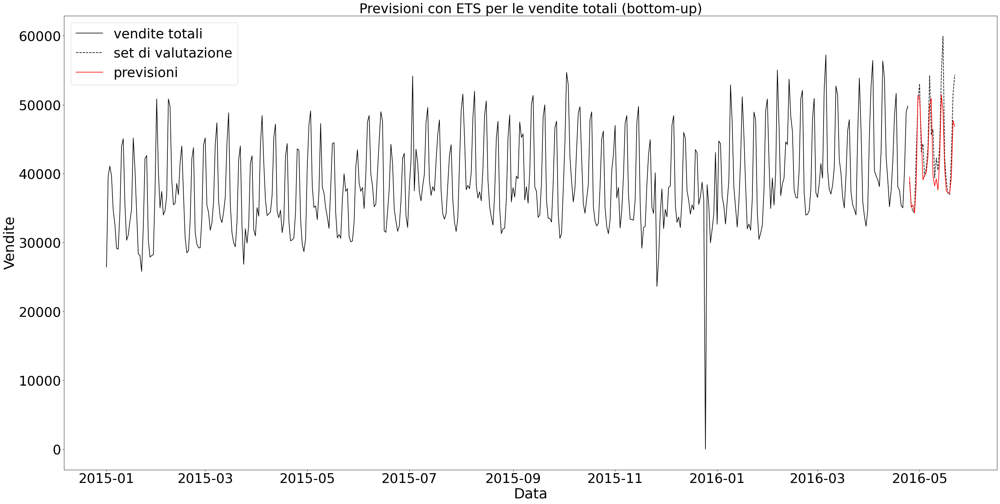

RMSE=3713.3248
MAE=2734.1371
MAPE=5.7696
Operazione completata
Forecast diretto sulle vendite totali...
MASE ETS_DECOMPOSITION_FORECASTING applicato a VENDITE TOTALI


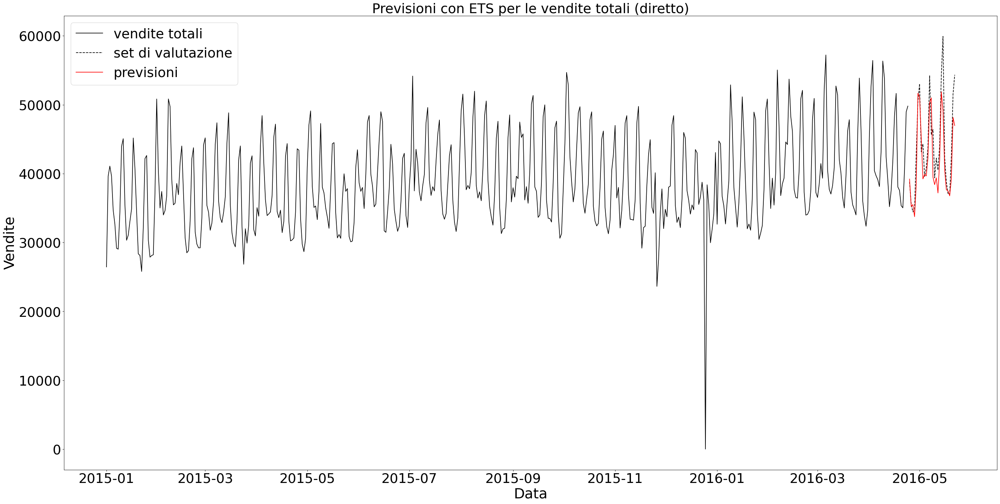

RMSE=3695.7082
MAE=2746.6567
MAPE=5.8267


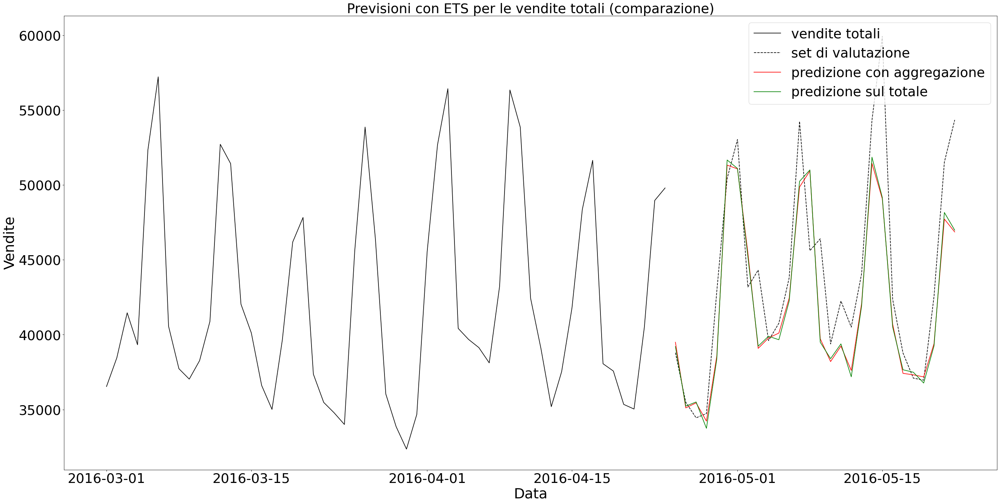

Operazione completata


In [6]:
    # Abbiamo la seguente gerarchia:
    # +(liv. 0)      vendite TOTALI
    # +(liv. 1)      vendite per STATO
    # +(liv. 2)      vendite per NEGOZIO
    # +(liv. 3)      vendite per NEGOZIO & CATEGORIA
    
    
    # noi usiamo l'approccio bottom-up. Prima realizziamo le previsioni
    # delle serie temporali per NEGOZIO & CATEGORIA poi raggruppiamo le serie temporali
    # per NEGOZIO ottenendo "vendite per NEGOZIO" poi raggruppando ulteriormente
    # abbiamo quelle per "STATO" e infine le vendite "TOTALI"
    
    # partiamo da NEGOZIO & CATEGORIA
    
    print('Stime modelli delle previsioni per NEGOZIO & CATEGORIA...')
    
    
    # Parte dove determiniamo i modelli predittivi delle serie di più basso livello nella gerarchia.
    # Dato che è molto lunga la generazione (più di 45 minuti) la lasciamo commentata e carichiamo
    # da file le previsioni precedentemente fatte.
    """
    ind = 0
    j = 0
    tsForecastingNegozioAndCat = []
    for ts in tsVenditeNegozioAndCat:
        model,forecasting = ETS_DECOMPOSITION_FORECASTING(ts,periodo=365, h=1941-1913)
        print(f'ETS_DECOMPOSITION_FORECASTING completato per {shopNames[j]}_{catNames[ind%3]}')
        tsForecastingNegozioAndCat.append(forecasting)
        if (ind+1)%3 == 0:
            j += 1
        ind += 1
        
    print('Operazione completata')
    
    # salviamo l'oggetto tsForecastingNegozioAndCat su un file per usarlo in momenti successivi
    print('Salvo l\'oggetto "tsForecastingNegozioAndCat" su file così da caricarlo in momenti successivi')
    
    save_obj(tsForecastingNegozioAndCat, './datasets/tsForecastingNegozioAndCat.pyobj')
    
    """
    
    tsForecastingNegozioAndCat = load_obj('./datasets/tsForecastingNegozioAndCat.pyobj')
    
    print('Caricamento di "tsForecastingNegozioAndCat" completato')
    
    
    # procediamo con il raggruppare le previsioni per NEGOZIO
    
    # 3 serie  per ogni negozio (CA1, CA2, CA3, CA4,   TX1, TX2, TX3,   WI1, W2, W3)
    
    print("Raggruppiamo le previsioni serie temporali per NEGOZIO...")
    ts_Ger_ForecastingNegozio = []
    i = 0
    j = 0
    while i < len(tsForecastingNegozioAndCat):
        ts_Ger_ForecastingNegozio.append(tsForecastingNegozioAndCat[i])
        ts_Ger_ForecastingNegozio[j] += tsForecastingNegozioAndCat[i+1]
        ts_Ger_ForecastingNegozio[j] += tsForecastingNegozioAndCat[i+2]
        i = i+3
        j += 1
    
    print('Operazione completata')
    
    # procediamo con il raggruppare le previsioni per STATO
    
    # 4 serie per lo stato CA
    # 3 serie per lo stato TX
    # 3 serie per lo stato WI
    
    print('Sommiamo le previsioni in base all\'appartenenza di un negozio ad uno STATO...')
    
    ts_Ger_ForecastingStato = []
    state = shopNames[0] + 'ABCD'     # stringa non presente nei nomi dei negozi
    ind = 0
    
    for s in shopNames:
        if state in s:
            ts_Ger_ForecastingStato[len(ts_Ger_ForecastingStato) - 1] += ts_Ger_ForecastingNegozio[ind]
        else:
            state = s[0:2]
            ts_Ger_ForecastingStato.append(ts_Ger_ForecastingNegozio[ind])
            
        ind += 1
    
    print('Operazione completata')
    
    
    # procediamo con il raggruppare le previsioni ottenendo le previsioni TOTALI
    # sommiamo le tre previsioni precedenti
    
    print('Sommiamo le previsioni per ogni STATO ottenendo le previsioni di vendita TOTALI...')
    
    ts_Ger_ForecastingVenditeTot = ts_Ger_ForecastingStato[0][:]    #[:] per eseguire una copia
    ts_Ger_ForecastingVenditeTot += ts_Ger_ForecastingStato[1]
    ts_Ger_ForecastingVenditeTot += ts_Ger_ForecastingStato[2]
    
    print('Operazione completata')
    
    
    print('Grafico delle previsioni per le vendite totali...')
    
    
    
    
    # operazioni per estrarre i dati reali da sales_train_evaluation.csv
    
    sales_train_evaluation = load_data('./datasets/sales_train_evaluation.csv')
    stateCAeval = sales_train_evaluation[sales_train_evaluation['state_id'] == 'CA']
    stateTXeval = sales_train_evaluation[sales_train_evaluation['state_id'] == 'TX']
    stateWIeval = sales_train_evaluation[sales_train_evaluation['state_id'] == 'WI']
    stateListEval = [stateCAeval, stateTXeval, stateWIeval]
    
    # definiamo l'array delle colonne
    giorni = []
    for column in stateCAeval:
        if 'd_' in column:
            giorni.append(column)
    
    tsVenditeStatoEval = []
    for state in stateListEval:
        tsVenditeStatoEval.append(pd.Series(data=sumrows(state, giorni), 
                                          index=pd.date_range(start=pd.Timestamp('2011-01-29'), periods=1941, freq='D')))
    
    tsVenditeTotEval = tsVenditeStatoEval[0][:]
    tsVenditeTotEval += tsVenditeStatoEval[1]
    tsVenditeTotEval += tsVenditeStatoEval[2]
    
    # ultimi 28 giorni
    tsVenditeTotValSet = tsVenditeTotEval[1913:]
    
    # creo il grafico
    tsVenditeTot = tsVenditeStato[0][:]
    tsVenditeTot += tsVenditeStato[1]
    tsVenditeTot += tsVenditeStato[2]
    plot_results([tsVenditeTot['2015-01-01':], tsVenditeTotValSet, ts_Ger_ForecastingVenditeTot], ['vendite totali', 'set di valutazione', 'previsioni'], 'Previsioni con ETS per le vendite totali (bottom-up)')

    
    # metriche di errore
    errore = ts_Ger_ForecastingVenditeTot - tsVenditeTotValSet
    #errore.dropna(inplace=True)
    print('RMSE=%.4f'%np.sqrt((errore ** 2).mean()))
    print('MAE=%.4f'%(abs(errore)).mean())
    print('MAPE=%.4f'%(abs(100*errore/tsVenditeTotValSet)).mean())

    print('Operazione completata')
    
    # %%
    
    print('Forecast diretto sulle vendite totali...')
    
    model, tsForecastingVenditeTot = ETS_DECOMPOSITION_FORECASTING(tsVenditeTot, periodo=365, h=1941-1913)
    print(f'MASE ETS_DECOMPOSITION_FORECASTING applicato a VENDITE TOTALI')
    
    plot_results([tsVenditeTot['2015-01-01':], tsVenditeTotValSet, tsForecastingVenditeTot], ['vendite totali', 'set di valutazione', 'previsioni'], 'Previsioni con ETS per le vendite totali (diretto)')
    
    # metriche di errore
    errore = tsForecastingVenditeTot - tsVenditeTotValSet
    #errore.dropna(inplace=True)
    print('RMSE=%.4f'%np.sqrt((errore ** 2).mean()))
    print('MAE=%.4f'%(abs(errore)).mean())
    print('MAPE=%.4f'%(abs(100*errore/tsVenditeTotValSet)).mean())
    
    # grafico comparativo
    plot_results([tsVenditeTot['2016-03-01':], tsVenditeTotValSet, ts_Ger_ForecastingVenditeTot, tsForecastingVenditeTot], ['vendite totali', 'set di valutazione', 'predizione con aggregazione', 'predizione sul totale'], 'Previsioni con ETS per le vendite totali (comparazione)')
    
    print('Operazione completata')

# [AGGIUNGERE QUALCHE FRASE QUI]

In [15]:
def p_q_for_ARIMA(timeseries):
    '''
    Calcola gli ordini p e q per il modello ARIMA (operazione eseguibile a vista, qui è stata resa
    automatica)
    -----------------
    Parametri:
    -----------------
        timeseries -> la serie temporale resa stazionaria con un metodo qualsiasi (dataframe)\n
    '''
    ACF = acf(timeseries, nlags=20)
    PACF = pacf(timeseries, nlags=20)
    limite = 1.96/np.sqrt(len(timeseries))
    p = 0
    q = 0
   
    for i in range(0, len(PACF)):
        if PACF[i] <= limite or i >= 6:
            p = i
            break
    for i in range(0, len(ACF)):
        if ACF[i] <= limite or i >= 4:
            q = i
            break
    return (p,q)

def ARIMA_DECOMPOSITION_FORECASTING(ts, periodo=365, h=100):
    '''
    La funzione ARIMA_FORECASTING calcola le previsioni delle serie temporali
    ritornando il modello e le previsioni
    Parameters
    ----------
    ts : pd.Series
        Serie temporale
    periodo : int, optional
        Il periodo di stagionalità. The default is 365.
    h : int, optional
        Orizzonte di previsione. The default is 100.
    Returns: 
    -------
    (model, model_forecasting) ovvero il modello e le previsioni
    '''
    decomposition = seasonal_decompose(ts, period=periodo)
    
    # salvo le parti decomposte in variabili 
    trend = decomposition.trend
    seasonal = decomposition.seasonal
    residual = decomposition.resid
    
    # rimuovo i valori null
    trend.dropna(inplace=True)
    seasonal.dropna(inplace=True)
    residual.dropna(inplace=True)    

    # Uso ARIMA su ogni componente della decomposizione. Cerco gli ordini 
    # di p e q ed applico ARIMA
    p, q = p_q_for_ARIMA(trend)
    flag = True
    while flag:
        try:
            try:
                trend_model = ARIMA(trend, order = (p, 0, q))
            except:
                trend_model = ARIMA(trend, order = (p, 1, q))
            trend_fitted = trend_model.fit(transparams=False)
            flag = False
        except:
            q -= 1
    
    p, q = p_q_for_ARIMA(seasonal)
    flag = True
    while flag:
        try:
            try:
                seasonal_model = ARIMA(seasonal, order = (p, 0, q))
            except:
                seasonal_model = ARIMA(seasonal, order = (p, 1, q))
            seasonal_fitted = seasonal_model.fit(transparams=False)
            flag = False
        except:
            q -= 1
        
    flag = True
    q = 5
    residual_fitted = None
    while flag:
        try:    
            residual_model = ARIMA(residual, order=(5, 0, q))
            #fit model
            residual_fitted = residual_model.fit()
            flag = False
        except:
            q -= 1
            
    # make prediction. Stesso periodo del validation set!    
    trend_model_predictions_array, _, _ = trend_fitted.forecast(steps=h)
    seasonal_model_predictions_array, _, _ = seasonal_fitted.forecast(steps=h)
    residual_model_predictions_array, _, _ = residual_fitted.forecast(steps=h)
    
    trend_model_predictions = pd.Series(data=seasonal_model_predictions_array,
                                           index=pd.date_range(start=pd.Timestamp('2016-04-25'), periods=28, freq='D'))
    seasonal_model_predictions = pd.Series(data=trend_model_predictions_array, 
                                           index=pd.date_range(start=pd.Timestamp('2016-04-25'), periods=28, freq='D'))
    residual_model_predictions = pd.Series(data=residual_model_predictions_array, 
                                           index=pd.date_range(start=pd.Timestamp('2016-04-25'), periods=28, freq='D'))
    
    #Sommo i modelli
    model = trend_fitted.fittedvalues \
                + seasonal_fitted.fittedvalues \
                + residual_fitted.fittedvalues

    #Sommo le previsioni
    model_forecasting = trend_model_predictions \
                        + seasonal_model_predictions \
                        + residual_model_predictions                       

    return (model, model_forecasting)

def find_best_model(ts, d=0, max_p=6, max_q=5):
    '''
    È la funzione che cerca il miglior modello ARMA per una serie temporale.
    Il miglior modello è colui che minimizza il grado AIC
    Parameters
    ----------
    ts : pandas.Series
        Serie temporale
    d : int, optional
        d di ARIMA(p,d,q). The default is 0.
    max_p : int, optional
        max valore di cerca per p. The default is 5.
    max_q : int, optional
        max valore di cerca per q. The default is 5.
    Returns 
    -------
    (p,d, result_model) : (int, int, ARIMAResults)
    '''
    min_aic = 2**32; p = 0; q = 0
    result_model = None
    for i in range(0, max_p):
        for j in range(0, max_q):
            try:
                #print('order(%d,%d,%d)'%(i,d,j))
                model = ARIMA(ts, order=(i, d, j)).fit(disp=-1)
                if (model.aic < min_aic):
                    p=i
                    q=j
                    min_aic=model.aic
                    result_model=model
            except:
                continue
    return (p,q, result_model)


def ARIMA_DECOMPOSITION_FORECASTING_2(ts, periodo=365, h=100):
    '''
    La funzione ARIMA_FORECASTING calcola le previsioni delle serie temporali
    ritornando il modello e le previsioni
    Parameters
    ----------
    ts : pd.Series
        Serie temporale
    periodo : int, optional
        Il periodo di stagionalità. The default is 365.
    h : int, optional
        Orizzonte di previsione. The default is 100.
    Returns: 
    -------
    (model, model_forecasting) ovvero il modello e le previsioni
    '''
    decomposition = seasonal_decompose(ts, period=periodo)
    
    # salvo le parti decomposte in variabili 
    trend = decomposition.trend
    seasonal = decomposition.seasonal
    residual = decomposition.resid
    
    # rimuovo i valori null
    trend.dropna(inplace=True)
    seasonal.dropna(inplace=True)
    residual.dropna(inplace=True)    

    _,_,trend_fitted = find_best_model(trend, d=1)
    _,_,seasonal_fitted = find_best_model(seasonal, d=0)
        
    flag = True
    q = 5
    residual_fitted = None
    while flag:
        try:    
            residual_model = ARIMA(residual, order=(5, 0, q))
            #fit model
            residual_fitted = residual_model.fit()
            flag = False
        except:
            q -= 1
            
    # make prediction. Stesso periodo del validation set!    
    trend_model_predictions_array, _, _ = trend_fitted.forecast(steps=h)
    seasonal_model_predictions_array, _, _ = seasonal_fitted.forecast(steps=h)
    residual_model_predictions_array, _, _ = residual_fitted.forecast(steps=h)
    
    trend_model_predictions = pd.Series(data=seasonal_model_predictions_array,
                                           index=pd.date_range(start=pd.Timestamp('2016-04-25'), periods=28, freq='D'))
    seasonal_model_predictions = pd.Series(data=trend_model_predictions_array, 
                                           index=pd.date_range(start=pd.Timestamp('2016-04-25'), periods=28, freq='D'))
    residual_model_predictions = pd.Series(data=residual_model_predictions_array, 
                                           index=pd.date_range(start=pd.Timestamp('2016-04-25'), periods=28, freq='D'))
    
    #Sommo i modelli
    model = trend_fitted.fittedvalues \
                + seasonal_fitted.fittedvalues \
                + residual_fitted.fittedvalues

    #Sommo le previsioni
    model_forecasting = trend_model_predictions \
                        + seasonal_model_predictions \
                        + residual_model_predictions                       

    return (model, model_forecasting)

def MAE_error(ts, model):
    errore = model - ts
    errore.dropna(inplace=True)

    return sum(abs(errore))/len(errore)

def HyndmanAndKoehler_error(ts, model, periodo=365):
    errore = model - ts
    errore.dropna(inplace=True)
    
    T = len(ts)
    denominatore = 0
    for i in range(periodo, T):
        denominatore += abs(ts[i] - ts[i - periodo])
    denominatore *= 1/(T - periodo)
    
    q = []
    for ej in errore:
        q.append(abs(ej)/denominatore)
    
    res = 0
    for i in range(0,len(q)):
        res += q[i]
    return res/len(q)

# [AGGIUNGERE QUALCHE FRASE QUI]

Caricamento di "tsForecastingNegozioAndCatARIMA" completato
Raggruppiamo le serie temporali per NEGOZIO...
Operazione completata
Sommiamo le previsioni in base all'appartenenza di un negozio ad uno STATO...
Operazione completata
Sommiamo le previsioni per ogni STATO ottenendo le previsioni di vendita TOTALI...
Operazione completata
Grafico delle previsioni per le vendite totali...


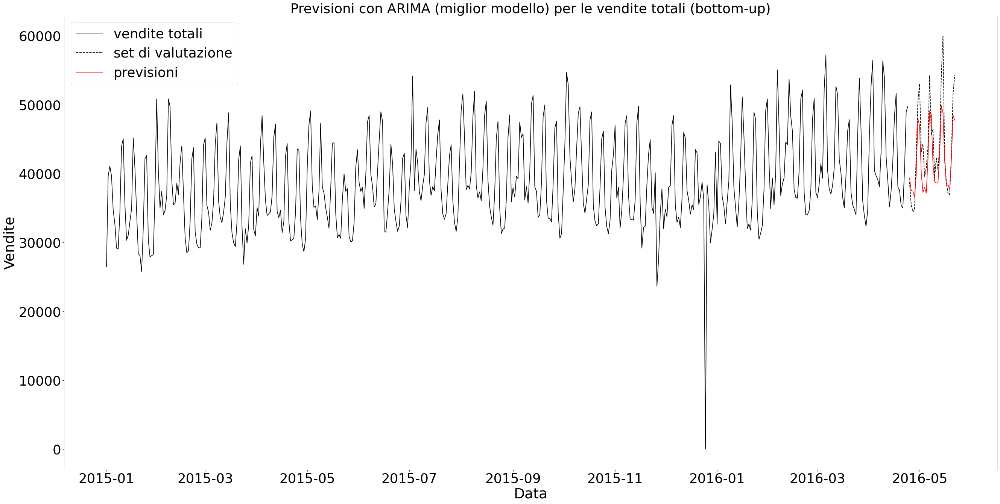

RMSE=3907.0195
MAE=3053.9147
MAPE=6.5422
Operazione completata
Forecast diretto sulle vendite totali...
MASE ARIMA_DECOMPOSITION_FORECASTING_2 DI VENDITE TOTALI = 6.342065166448484


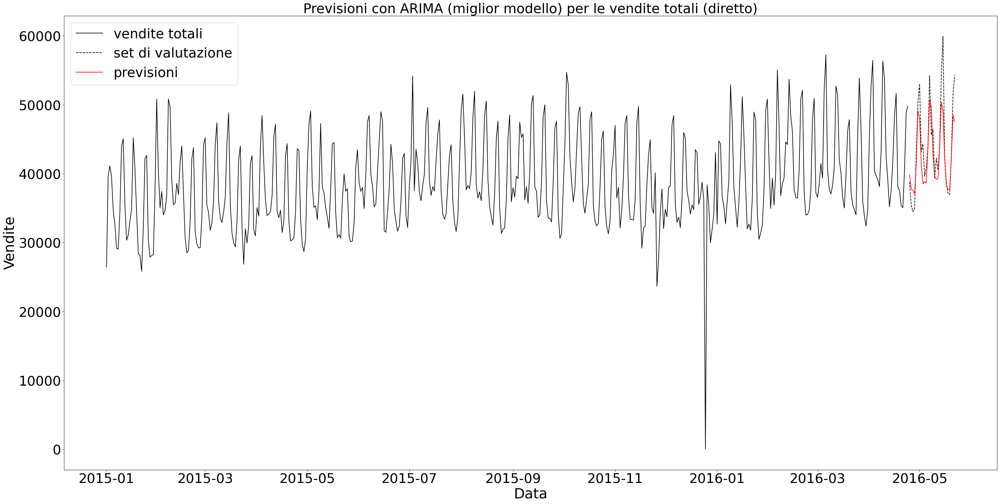

RMSE=3479.2730
MAE=2513.4834
MAPE=5.3577


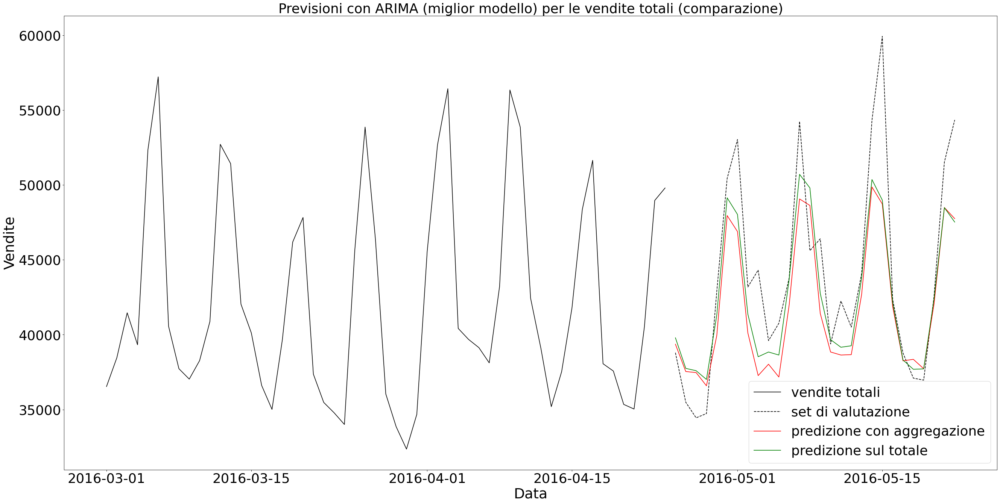

Operazione completata


In [16]:
    # Abbiamo la seguente gerarchia:
    # +(liv. 0)      vendite TOTALI
    # +(liv. 1)      vendite per STATO
    # +(liv. 2)      vendite per NEGOZIO
    # +(liv. 3)      vendite per NEGOZIO & CATEGORIA
    
    
    # Quindi noi usando l'approccio bottom-up prima realizziamo le previsioni
    # delle serie temporali per NEGOZIO & CATEGORIA poi raggruppiamo le serie temporali
    # per NEGOZIO ottenendo "vendite per NEGOZIO" poi raggruppando ulteriormente
    # abbiamo quelle per "STATO" e infine le vendite "TOTALI"
    
    # partiamo da NEGOZIO & CATEGORIA
    """
    print('Stime modelli delle previsioni per NEGOZIO & CATEGORIA con ARIMA...')
    
    ind = 0
    j = 0
    tsForecastingNegozioAndCat = []
    for ts in tsVenditeNegozioAndCat:
        model,forecasting = ARIMA_DECOMPOSITION_FORECASTING_2(ts, periodo=7, h=1941-1913)
        mase = HyndmanAndKoehler_error(ts, model)
        print(f'MASE ARIMA_DECOMPOSITION_FORECASTING DI {shopNames[j]}_{catNames[ind%3]} = {mase}')
        tsForecastingNegozioAndCat.append(forecasting)
        if (ind+1)%3 == 0:
            j += 1
        ind += 1
        
    print('Operazione completata')
    
    # %%
    print('Salvo l\'oggetto "tsForecastingNegozioAndCatARIMA" su file così da caricarlo in momenti successivi')
    
    save_obj(tsForecastingNegozioAndCat, './datasets/tsForecastingNegozioAndCatARIMA.pyobj')
    """
    # %%
    tsForecastingNegozioAndCat = load_obj('./datasets/tsForecastingNegozioAndCatARIMA.pyobj')
    
    print('Caricamento di "tsForecastingNegozioAndCatARIMA" completato')
    
    # %%
    """
    print('Stime modelli delle previsioni per NEGOZIO...')
    
    ind = 0
    tsForecastingNegozio = []
    for ts in tsVenditeNegozio:
        model,forecasting = ETS_DECOMPOSITION_FORECASTING(ts,periodo=365, h=1941-1913)
        mase = HyndmanAndKoehler_error(ts, model)
        print(f'MASE ETS_DECOMPOSITION_FORECASTING DI {shopNames[ind]} = {mase}')
        tsForecastingNegozio.append(forecasting)
        ind+=1
        
    print('Operazione completata')
    
    print('Salvo l\'oggetto "tsForecastingNegozio" su file così da caricarlo in momenti successivi')
    save_obj(tsForecastingNegozio, 'tsForecastingNegozio.pyobj')

    tsForecastingNegozio = load_obj('tsForecastingNegozio.pyobj')
    print('Caricamento di "tsForecastingNegozio" completato')
    """
    # %%
    
    print("Raggruppiamo le serie temporali per NEGOZIO...")
    
    tsForecastingNegozio = []
    i = 0
    j = 0
    while i < len(tsForecastingNegozioAndCat):
        tsForecastingNegozio.append(tsForecastingNegozioAndCat[i])
        tsForecastingNegozio[j] += tsForecastingNegozioAndCat[i+1]
        tsForecastingNegozio[j] += tsForecastingNegozioAndCat[i+2]
        i = i+3
        j += 1
    
    print('Operazione completata')
    
    # %%
    
    print('Sommiamo le previsioni in base all\'appartenenza di un negozio ad uno STATO...')
    
    ts_Ger_ForecastingStato = []
    state = shopNames[0] + 'ABCD'     # stringa non presente nei nomi dei negozi
    ind = 0
    
    for s in shopNames:
        if state in s:
            ts_Ger_ForecastingStato[len(ts_Ger_ForecastingStato) - 1] += tsForecastingNegozio[ind]
        else:
            state = s[0:2]
            ts_Ger_ForecastingStato.append(tsForecastingNegozio[ind])
            
        ind += 1
    
    print('Operazione completata')
    
    print('Sommiamo le previsioni per ogni STATO ottenendo le previsioni di vendita TOTALI...')
    
    ts_Ger_ForecastingVenditeTot = ts_Ger_ForecastingStato[0][:]    #[:] per eseguire una copia
    ts_Ger_ForecastingVenditeTot += ts_Ger_ForecastingStato[1]
    ts_Ger_ForecastingVenditeTot += ts_Ger_ForecastingStato[2]
    
    print('Operazione completata')
    
    # %%
    
    print('Grafico delle previsioni per le vendite totali...')
    
    # operazioni per estrarre i dati reali da sales_train_evaluation.csv
    sales_train_evaluation = load_data('./datasets/sales_train_evaluation.csv')
    stateCAeval = sales_train_evaluation[sales_train_evaluation['state_id'] == 'CA']
    stateTXeval = sales_train_evaluation[sales_train_evaluation['state_id'] == 'TX']
    stateWIeval = sales_train_evaluation[sales_train_evaluation['state_id'] == 'WI']
    stateListEval = [stateCAeval, stateTXeval, stateWIeval]
    
    giorni = []
    for column in stateCAeval:
        if 'd_' in column:
            giorni.append(column)
    
    tsVenditeStatoEval = []
    for state in stateListEval:
        tsVenditeStatoEval.append(pd.Series(data=sumrows(state, giorni), 
                                          index=pd.date_range(start=pd.Timestamp('2011-01-29'), periods=1941, freq='D')))
    
    tsVenditeTotEval = tsVenditeStatoEval[0][:]
    tsVenditeTotEval += tsVenditeStatoEval[1]
    tsVenditeTotEval += tsVenditeStatoEval[2]
    
    # ultimi 28 giorni
    tsVenditeTotValSet = tsVenditeTotEval[1913:]
    
    # creo il grafico
    tsVenditeTot = tsVenditeStato[0][:]
    tsVenditeTot += tsVenditeStato[1]
    tsVenditeTot += tsVenditeStato[2]
    plot_results([tsVenditeTot['2015-01-01':], tsVenditeTotValSet, ts_Ger_ForecastingVenditeTot], ['vendite totali', 'set di valutazione', 'previsioni'], 'Previsioni con ARIMA (miglior modello) per le vendite totali (bottom-up)')

    # metriche di errore
    errore = ts_Ger_ForecastingVenditeTot - tsVenditeTotValSet
    #errore.dropna(inplace=True)
    print('RMSE=%.4f'%np.sqrt((errore ** 2).mean()))
    print('MAE=%.4f'%(abs(errore)).mean())
    print('MAPE=%.4f'%(abs(100*errore/tsVenditeTotValSet)).mean())

    print('Operazione completata')
    
    # %%
    
    print('Forecast diretto sulle vendite totali...')
    
    model, tsForecastingVenditeTot = ARIMA_DECOMPOSITION_FORECASTING_2(tsVenditeTot, periodo=7, h=1941-1913)
    mase = HyndmanAndKoehler_error(tsVenditeTot, model)
    print(f'MASE ARIMA_DECOMPOSITION_FORECASTING_2 DI VENDITE TOTALI = {mase}')
    
    plot_results([tsVenditeTot['2015-01-01':], tsVenditeTotValSet, tsForecastingVenditeTot], ['vendite totali', 'set di valutazione', 'previsioni'], 'Previsioni con ARIMA (miglior modello) per le vendite totali (diretto)')
    
    # metriche di errore
    errore = tsForecastingVenditeTot - tsVenditeTotValSet
    #errore.dropna(inplace=True)
    print('RMSE=%.4f'%np.sqrt((errore ** 2).mean()))
    print('MAE=%.4f'%(abs(errore)).mean())
    print('MAPE=%.4f'%(abs(100*errore/tsVenditeTotValSet)).mean())
    
    # grafico comparativo
    plot_results([tsVenditeTot['2016-03-01':], tsVenditeTotValSet, ts_Ger_ForecastingVenditeTot, tsForecastingVenditeTot], ['vendite totali', 'set di valutazione', 'predizione con aggregazione', 'predizione sul totale'], 'Previsioni con ARIMA (miglior modello) per le vendite totali (comparazione)')
    
    print('Operazione completata')

### Osservazioni

|      | vendite totali (bottom-up)  | vendite totali (forecasting diretto)  |
| ---  |   -------: | -------: |
| MAPE |     5.7696 |   5.8267 |
| MAE  |  2734.1371 |2746.6567 |

Come possiamo vedere, le metriche d'errore fra le previsioni dirette e le previsioni usando l'approccio bottom-up non si discostano molto. Il grande vantaggio delle serie gerarchiche è che le serie temporali sono legate e quindi anche le loro previsioni. Eseguendo il forecasting delle serie temporali alla base della gerarchia riusciamo ad ottenere anche le previsioni di tutte le serie che fanno parte della gerarchia creando $m$ modelli.

# Bibliografia

- Test Dickey-Fuller: https://machinelearningmastery.com/time-series-data-stationary-python/
- Exponential Smoothing: https://otexts.com/fpp2/ses.html
- Triple Exponential Smoothing: https://grisha.org/blog/2016/01/29/triple-exponential-smoothing-forecasting/ , https://www.itl.nist.gov/div898/handbook/pmc/section4/pmc435.htm
- Stagionalità complesse: https://otexts.com/fpp2/complexseasonality.html
- Modello TBATS: https://robjhyndman.com/publications/complex-seasonality/
- Serie di Fourier: https://otexts.com/fpp2/useful-predictors.html
- Applicazione del modello TBATS: https://medium.com/intive-developers/forecasting-time-series-with-multiple-seasonalities-using-tbats-in-python-398a00ac0e8a
- Metodo di decomposizione: https://local.disia.unifi.it/marliani/stat_eco_A/seriestoriche2.pdf
- Serie gerarchiche: https://robjhyndman.com/files/3-Hierarchical.pdf